## MIIA-4203 MODELOS AVANZADOS PARA ANÁLISIS DE DATOS II


# Red neuronal profunda

## Integrantes:

        - Luis Jorge García Camargo
        - Fernando Pérez Moreno


### Profesor: Camilo Franco (c.franco31@uniandes.edu.co)

En este cuadernos estudiaremos las redes profundas. Implementaremos nuestra propia red utilizando la biblioteca (API) Keras (https://keras.io/).   

Identificaremos nuestros mejores modelos según la arquitectura de red, intentando redes multi-capa densamente conectadas y haciendo uso de regularización para el cálculo de su función de pérdida. 

Probaremos nuestros modelos más complejos de *deep learning* para la detección automática de frailejones sobre imagenes aereas del páramo e intentaremos mejorar los resultados que obtuvimos con nuestras redes más sencillas. Recordemos que hasta ahora hemos logrado unos resultados preliminares con un *accuracy* de validación de 0.86, utilizando una red sencilla de 5 neuronas. 

Importemos algunos de los paquetes que vamos a utilizar:


In [1]:
import numpy as np
import h5py
import matplotlib.pyplot as plt

from ImportImagenesRGB import *
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix 

%load_ext autoreload
%autoreload 2

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

from prettytable import PrettyTable
import datetime

import keras
from keras.models import Sequential, load_model
from keras.optimizers import SGD
from keras.layers import Activation, Dropout, Flatten, Dense

from numpy.random import seed
seed(1)


## 1. Redes , Validación cruzada doble (DVC) y GD estocástico (SGD)

A continuacion repliquemos el modelo de red sencilla con 5 neuronas que ya construimos paso a paso en clases anteriores. Pero esta vez utilizando la funcion `model`de Keras, que añade capas secuencialmente.

###  Validación cruzada doble (DCV)
Repetimos varias veces el entrenamiento, validación y *prueba* de los modelos con distintas particiones de los datos, implementando una *validación cruzada doble* con el fin de obtener una estimación insesgada del error de predicción (para mayores detalles ver Filmozer et al (2009), http://www.libpls.net/publication/rdCV_2009.pdf) Esta implementación es útil cuando tenemos pocos datos.

### Descenso en la Dirección del Gradiente Estocástico (SGD) 
Para esta primera red sencilla, el proceso de optimización lo vamos a implementar de acuerdo con el método de Descenso en la Dirección del Gradiente Estocástico (SGD). Como ya hemos visto, el método de Descenso en la direccion del gradiente es un método iterativo que permite optimizar funciones objetivo diferenciables, donde 

$$ \hat \theta_{nuevo} = \hat \theta_{viejo} - \alpha \frac{\partial J(\hat \theta_{viejo}; X, Y) }{ \partial \hat \theta_{viejo} }$$ 

siendo $\alpha$ la tasa de aprendizaje y $\theta$ nuestro parámetro a estimar.


La parte estocástica se refiere a que en lugar de utilizar todos los datos en cada paso iterativo, utilizamos una observación (elegida de manera aleatoria) en cada paso. De esta manera, el SGD permite reducir el coste computacional del proceso de optimización, iterando más rápidamente pero con un tasa de convergencia ligeramente menor y más **oscilante**. 

Entonces, el SGD se puede formular de la siguiente manera

$$ \hat \theta_{nuevo} = \hat \theta_{viejo} - \alpha \frac{\partial J (\hat \theta_{viejo}; x^{(i)}, y^{(i)})}{ \partial \hat \theta_{viejo} }$$ 



Fijémnos que una variación del GD a *medio-camino* del SGD es el GD en *batches* o subconjuntos de datos con un tamaño dado (16, 32, 64,...), el cual optimiza sobre distintos subconjuntos (aleatoriamente seleccionados) del total de los datos en cada iteración.


Además se tienen otras modificaciones sobre el SGD. La más opular es la adición de un término de *momentum*.

### SGD con momentum

Recordando las nociones de física, el término *momentum* hace referencia al algoritmo que avanza a lo largo del espacio paramétrico en búsqueda del óptimo (local), aceleradno de acuerdo con el gradiente de la pérdida (que guardando la anlogía con la física, se refiere a la fuerza). De esta manera, modificando el GD clásico, pues mantiene la misma dirección a medida que avanza disminuyendo las oscilaciones. 

Este método hace parte de la literatura del aprendizaje computacional basado en la *retro-propagación* (Rumelhart et al. (1986) https://www.nature.com/articles/323533a0) 

El SGD con momentum actualiza los estimadores como una combinación lineal entre el gradiente y la actualización previa, implementando un promedio suavizado:


$$ \hat \theta_{nuevo} = \eta \hat \theta_{viejo} - \alpha \frac{\partial J (\hat \theta_{viejo}; x^{(i)}, y^{(i)})}{ \partial \hat \theta_{viejo} }$$ 

donde $\eta$ es el factor de decrecimiento exponencial que toma valores entre 0 y 1. Así, $\eta$ permite incorporar la contribución relativa entre el gradiente actual y de gradientes anteriores. 


A continuación importemos las imagenes:

In [2]:
X,Y = import_imagenes_RGB()

print(X.shape, Y.shape, X[0,0,0])

(250, 70, 70, 3) (1, 250) [0.58823529 0.5372549  0.40392157]


**Salida esperada:**

(250, 70, 70, 3) (1, 250) [0.58823529 0.5372549  0.40392157]


In [3]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])
Acc_E = []
Acc_V = []
Acc_P = []

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=1000

# Definimos los parametros del SGD
sgd = SGD(lr=0.01, momentum=0.001)
# junto con la inicialización aleatoria
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)

# inicializamos el error para guardar el mejor modelo
err_p = 999
  
# implementamos 3 repeticiones con particiones distintas de entrenamiento y doble validacion
for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Especificamos la arquitectura de la red 
    model = Sequential()  
    model.add(Flatten(input_shape=CE_x.shape[1:]))
    model.add(Dense(5, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros'))
    model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=sgd, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False) 
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
            
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        pathr =('modelo_redsencilla_initseed=1_part_seed='+str(r)+'numn=5.h5')
        model.save(pathr) 
        err_p = loss_p
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' y accu_v='+str(accu_v))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])
    
    # Exactitud media
    Acc_E.append(accu_e)
    Acc_V.append(accu_v)
    Acc_P.append(accu_p)

print(x)

print('Accuracies de Entrenamiento: '+str(np.round(np.mean(Acc_E),3))
      +'; Validacion1: '+str(np.round(np.mean(Acc_V),3))+ '; Validacion2: '+str(np.round(np.mean(Acc_P),3)))

Epoca= 764 y accu_v=0.7837837934494019
Epoca= 640 y accu_v=0.8648648858070374
Epoca= 412 y accu_v=0.8108108043670654
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
| 0.9943 | 0.7838 | 0.8158 |  764  |
| 0.9829 | 0.8649 | 0.7895 |  640  |
| 0.9714 | 0.8108 | 0.7895 |  412  |
+--------+--------+--------+-------+
Accuracies de Entrenamiento: 0.983; Validacion1: 0.82; Validacion2: 0.798


Graficamos el desempeño del modelo:

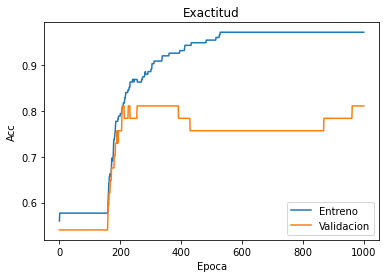

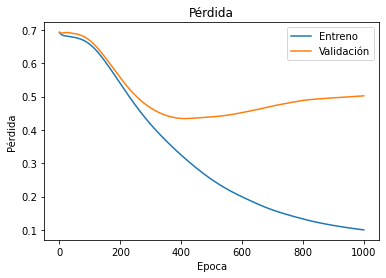

In [4]:
plt.figure(1)
plt.plot(history.history['accuracy'])  
plt.plot(history.history['val_accuracy'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

Confirmamos que podemos cargar de nuevo el modelo que guardamos:

In [5]:
# red sencilla 5 neuronas
model_1 = load_model('modelo_redsencilla_initseed=1_part_seed=3numn=5.h5')

### Pregunta 1.1

Cuántos parámetros debemos estimar en esta red sencilla?

In [6]:
model_1.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten (Flatten)            (None, 14700)             0         
_________________________________________________________________
dense (Dense)                (None, 5)                 73505     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 6         
Total params: 73,511
Trainable params: 73,511
Non-trainable params: 0
_________________________________________________________________


Esta red sencilla se compone de $(14700+1)*5+(5+1)*1=73511$ parámetros, ya que son 14700 variables en capa de entrada que se transforman en 5 nuevos inputs con su respectivo término de sesgo y en la capa de salida los 5 parámetos asociados a esta capa con el término de sesgo.

Si se quiere establecer cuántos parámetros está estimando el procedimiento anterior con SGD, se están haciendo tres repeticiones, para un total de parámetros de 220533.

### Replicabilidad

Confirmamos el desempeño del modelo sobre todo el conjunto de datos:

In [7]:
Y_pred = model_1.predict(X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[140,   5],
       [ 11,  94]], dtype=int64)

**Salida esperada:**
    
<table style="width:20%">
    <tr>
       <td> 140 </td>
       <td> 5 </td>
    </tr>
    <tr>
       <td> 7 </td>
       <td> 98 </td>
    </tr>

</table>

    

### Ejercicio 1.1

Busque un mejor modelo intentando diferentes inicializaciones para la estimación de los parámetros.

#### Inicializador Xavier

In [8]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])
Acc_E = []
Acc_V = []
Acc_P = []

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=1000

# Definimos los parametros del SGD
sgd = SGD(lr=0.01, momentum=0.001)
# junto con la inicialización aleatoria
# initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)
init_xav = keras.initializers.GlorotNormal(seed=1)
# inicializamos el error para guardar el mejor modelo
err_p = 999
  
# implementamos 3 repeticiones con particiones distintas de entrenamiento y doble validacion
for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Especificamos la arquitectura de la red 
    model = Sequential()  
    model.add(Flatten(input_shape=CE_x.shape[1:]))
    model.add(Dense(5, activation='sigmoid', kernel_initializer=init_xav, bias_initializer='zeros'))
    model.add(Dense(1, activation='sigmoid', kernel_initializer=init_xav, bias_initializer='zeros')) 
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=sgd, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False) 
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
            
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        pathr =('I=Xavmodelo_redsencilla_initseed=1_part_seed='+str(r)+'numn=5.h5')
        model.save(pathr) 
        err_p = loss_p
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' y accu_v='+str(accu_v))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])
    
    # Exactitud media
    Acc_E.append(accu_e)
    Acc_V.append(accu_v)
    Acc_P.append(accu_p)

print(x)

print('Accuracies de Entrenamiento: '+str(np.round(np.mean(Acc_E),3))
      +'; Validacion1: '+str(np.round(np.mean(Acc_V),3))+ '; Validacion2: '+str(np.round(np.mean(Acc_P),3)))



Epoca= 340 y accu_v=0.8108108043670654
Epoca= 252 y accu_v=0.8108108043670654
Epoca= 205 y accu_v=0.7837837934494019
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
|  1.0   | 0.8108 | 0.8684 |  340  |
| 0.9943 | 0.8108 | 0.7895 |  252  |
| 0.9943 | 0.7838 | 0.7895 |  205  |
+--------+--------+--------+-------+
Accuracies de Entrenamiento: 0.996; Validacion1: 0.802; Validacion2: 0.816


#### Inicializador de matrices ortogonales

In [9]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])
Acc_E = []
Acc_V = []
Acc_P = []

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=1000

# Definimos los parametros del SGD
sgd = SGD(lr=0.01, momentum=0.001)
# junto con la inicialización aleatoria
# initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)
# init_xav = keras.initializers.GlorotNormal(seed=1)
init_ortog = keras.initializers.Orthogonal(gain=1.0, seed=None)
# inicializamos el error para guardar el mejor modelo
err_p = 999
  
# implementamos 3 repeticiones con particiones distintas de entrenamiento y doble validacion
for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Especificamos la arquitectura de la red 
    model = Sequential()  
    model.add(Flatten(input_shape=CE_x.shape[1:]))
    model.add(Dense(5, activation='sigmoid', kernel_initializer=init_ortog, bias_initializer='zeros'))
    model.add(Dense(1, activation='sigmoid', kernel_initializer=init_ortog, bias_initializer='zeros')) 
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=sgd, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False) 
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
            
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        pathr =('I=Ortogmodelo_redsencilla_initseed=1_part_seed='+str(r)+'numn=5.h5')
        model.save(pathr) 
        err_p = loss_p
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' y accu_v='+str(accu_v))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])
    
    # Exactitud media
    Acc_E.append(accu_e)
    Acc_V.append(accu_v)
    Acc_P.append(accu_p)

print(x)

print('Accuracies de Entrenamiento: '+str(np.round(np.mean(Acc_E),3))
      +'; Validacion1: '+str(np.round(np.mean(Acc_V),3))+ '; Validacion2: '+str(np.round(np.mean(Acc_P),3)))



Epoca= 319 y accu_v=0.8108108043670654
Epoca= 700 y accu_v=0.8648648858070374
Epoca= 408 y accu_v=0.8108108043670654
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
|  1.0   | 0.8108 | 0.8421 |  319  |
| 0.9829 | 0.8649 | 0.7895 |  700  |
| 0.9771 | 0.8108 | 0.7895 |  408  |
+--------+--------+--------+-------+
Accuracies de Entrenamiento: 0.987; Validacion1: 0.829; Validacion2: 0.807


Se propone cambiar la inicialización de parámetros en primer lugar por el inicializador normal de Xavier y en segundo lugar por un inicializador de matrices ortogonales. Hasta el momento el que mejor desempeño ha tenido en términos de accuracy es el inicializador de Xavier normal.

## 2. Redes profundas

Ahora implementemos una red multi-capa, añadiendo más capas al modelo. Primero definimos la técnica de inicialización de He que vimos la clase pasada, la cual está pensada para aliviar el entenamiento de redes profundas con funciones de activación basadas en los rectficadores ReLU.

Recordemos que la inicialización de He para los parametros $W^{[l]}$ consiste en multiplicar sus valores iniciales por  $\sqrt{\frac{2}{n_l}}$.


Ahora, para esta red profunda, vamos a utilizar un método de optimización que nos ayude a reducir el coste computacional que conlleva un número aumentado de parámetros a estimar.

### Propagación de la raiz cuadrada del Cuadrado Medio (RMSProp)

El método de propagación de la raiz cuadrada del cuadrado medio (RMSProp *Root Mean Square Propagation*) permite adaptar la tasa de aprendizaje para cada uno de los parámetros. Esto se hace dividiendo la tasa de aprendizaje (para un parámetro) por un promedio móvil de las magnitudes de los gradientes recientes (ver https://www.cs.toronto.edu/~tijmen/csc321/slides/lecture_slides_lec6.pdf ) 

De esta manera, un primer promedio movil se calcula en términos de los cuadrados medios del gradiente y el parámetro $\rho$ que representa un factor de memoria a corto plazo sobre los gradientes recientes:

$$ v(\theta) = \rho v(\theta_{viejo}) + (1-\rho) \biggr( \frac{\partial J (\hat \theta_{viejo}; x^{(i)}, y^{(i)})}{ \partial \hat \theta_{viejo} } \biggl)^2  $$


De tal manera que la actualización de los parámetros se lleva a cabo mediante:

$$ \hat \theta_{nuevo} = \hat \theta_{viejo} - \frac{\alpha}{\sqrt{v(\theta)}} \frac{\partial J (\hat \theta_{viejo}; x^{(i)}, y^{(i)})}{ \partial \hat \theta_{viejo} }$$ 

Esta implementación del RMSProp permite adaptar la tasa de aprendizaje sobre la optimización con todos los datos o pequeños subconjuntos de los datos. 


Antes de especificar la estructura de la red, primero definamos la inicializacion de He:

In [10]:
initHe = keras.initializers.he_normal(seed=1)

Veamos cómo podemos agregar más capas al modelo que definimos con la ayuda de Keras. A continuación definimos la arquitectura de la red, una con inicializacion aleatoria normal y otra con la incializacion de He:

In [11]:
model = Sequential()  
model.add(Flatten(input_shape=X.shape[1:]))
model.add(Dense(700, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(400, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(100, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(50, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(15, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 
    
# Guardamos la arquitectura de red
config_norm = model.get_config()

In [12]:
model = Sequential()   
model.add(Flatten(input_shape=X.shape[1:]))
model.add(Dense(700, activation='relu', kernel_initializer=initHe, bias_initializer='zeros')) 
model.add(Dense(400, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(100, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(50, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(15, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 
    
# Guardamos la arquitectura de red
config_He = model.get_config()

Ahora implementamos el codigo para buscar el mejor modelo con la arquitectura arriba definida, probando ambos métodos de incialización:

Inicio Init=Normal:2020-09-19 10:19:52.199280
Epoca= 179 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= Normal:2020-09-19 10:23:19.000662


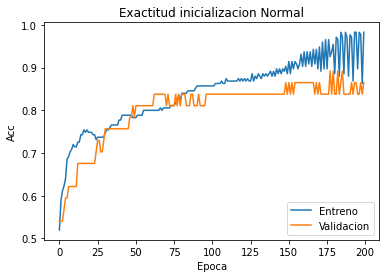

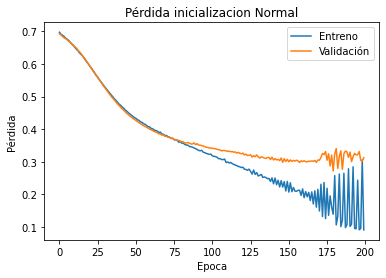

Inicio Init=He:2020-09-19 10:23:19.462681
Epoca= 148 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 10:26:30.568251


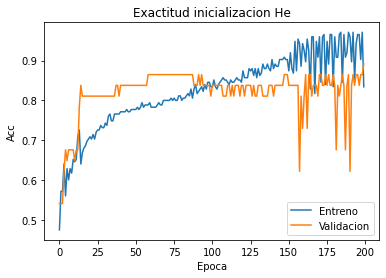

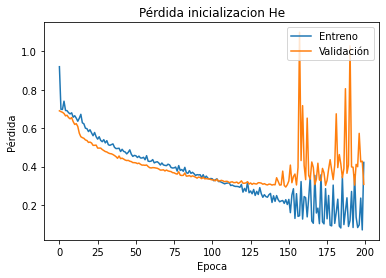

+--------+--------+--------+-------+--------+
| Exac_E | Exac_V | Exac_P | Epoca |  Init  |
+--------+--------+--------+-------+--------+
|  1.0   | 0.8919 | 0.8421 |  179  | Normal |
|  1.0   | 0.8649 | 0.8421 |  148  |   He   |
+--------+--------+--------+-------+--------+


In [13]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca", "Init"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=200

# Definimos los parametros del RMSProp
rmsprop = keras.optimizers.RMSprop(lr=0.00008, rho=0.9)

# implementamos 2 repeticiones, una con inicializacion aleatoria Normal y otra con He
for i in range(2):
    if(i==0):
        model = Sequential.from_config(config_norm)
        init = "Normal"
        tiempo0 = datetime.datetime.now()
        print('Inicio Init=' +str(init)+':' +str(tiempo0))
    elif(i==1):
        model = Sequential.from_config(config_He)
        init = "He"
        tiempo0 = datetime.datetime.now()
        print('Inicio Init=' +str(init)+':' +str(tiempo0))
        
    # Partimos los datos en entrenamiento y doble validación
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(X, Y.T, test_size = 0.3, random_state = 8)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = 8)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=rmsprop, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)  
  
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en la primera validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
           
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    pathr =('modelo_redprofunda_initseed=1_part_seed=8_Init='+str(init)+'.h5')
    model.save(pathr) 
    err_p = loss_p
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0], init])
    
    # Imprimimos el desempeño para cada inicializacion y el tiempo en completar las iteraciones
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    tiempo1 = datetime.datetime.now()
    print('Fin Init= ' +str(init)+':' +str(tiempo1))
    
    # Graficamos el desempeño del modelo
    plt.figure(1)
    plt.plot(history.history['accuracy'])  
    plt.plot(history.history['val_accuracy'])  
    plt.title('Exactitud inicializacion ' +str(init))  
    plt.ylabel('Acc')  
    plt.xlabel('Epoca')  
    plt.legend(['Entreno', 'Validacion'], loc='lower right')
    plt.show()

    plt.figure(1) 
    plt.plot(history.history['loss'])  
    plt.plot(history.history['val_loss'])  
    plt.title('Pérdida inicializacion ' +str(init))  
    plt.ylabel('Pérdida')  
    plt.xlabel('Epoca')  
    plt.legend(['Entreno', 'Validación'], loc='upper right')  
    plt.show()

print(x)

### Pregunta 2.1

Qué método de inicialización ayuda más a la convergencia del modelo?

#### Solución:
Para este caso en particular, con el optimizador RMSProp, la convergencia del modelo presenta mejores resultados con el inicializador de He, comparado con el inicializador normal.

Cargamos el mejor modelo y confirmamos el desempeño del modelo sobre todo el conjunto de datos:

In [14]:
# red profunda de 6 capas
model_2 = load_model('modelo_redprofunda_initseed=1_part_seed=8_Init=Normal.h5')

model_2.summary()

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_9 (Flatten)          (None, 14700)             0         
_________________________________________________________________
dense_18 (Dense)             (None, 700)               10290700  
_________________________________________________________________
dense_19 (Dense)             (None, 400)               280400    
_________________________________________________________________
dense_20 (Dense)             (None, 100)               40100     
_________________________________________________________________
dense_21 (Dense)             (None, 50)                5050      
_________________________________________________________________
dense_22 (Dense)             (None, 15)                765       
_________________________________________________________________
dense_23 (Dense)             (None, 1)                

In [15]:
Y_pred = model_2.predict(X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[139,   6],
       [  4, 101]], dtype=int64)

**Salida esperada (aproximada):**
    
<table style="width:20%">
    <tr>
       <td> 139 </td>
       <td> 6 </td>
    </tr>
    <tr>
       <td> 6 </td>
       <td> 99 </td>
    </tr>

</table>

### Ejercicio 2.1

Explore la implementación de regularizacion L1 y L2 sobre la última capa escondida para mejorar el desempeño en validación de la red.



*Ayuda: visite la pagina de Keras https://keras.io/regularizers/
para aplicar regularización sobre la magnitud de los parametros, implemente `kernel_regularizer`
Por ejemplo, si queremos una regularización L2 con una constante de 0.01, escribimos `kernel_regularizer=regularizers.l2(0.01)`


In [16]:
kernel_reg_l1=keras.regularizers.l1(0.01)
kernel_reg_l2=keras.regularizers.l2(0.01)

model = Sequential()   
model.add(Flatten(input_shape=X.shape[1:]))
model.add(Dense(700, activation='relu', kernel_initializer=initHe, bias_initializer='zeros')) 
model.add(Dense(400, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(100, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(50, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(15, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(1, activation='sigmoid', kernel_initializer=initHe, bias_initializer='zeros', kernel_regularizer=kernel_reg_l1)) 
    
# Guardamos la arquitectura de red
config_he_l1 = model.get_config()

model = Sequential()   
model.add(Flatten(input_shape=X.shape[1:]))
model.add(Dense(700, activation='relu', kernel_initializer=initHe, bias_initializer='zeros')) 
model.add(Dense(400, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(100, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(50, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(15, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model.add(Dense(1, activation='sigmoid', kernel_initializer=initHe, bias_initializer='zeros', kernel_regularizer=kernel_reg_l2)) 
    
# Guardamos la arquitectura de red
config_he_l2 = model.get_config()

model = Sequential()   
model.add(Flatten(input_shape=X.shape[1:]))
model.add(Dense(700, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros')) 
model.add(Dense(400, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(100, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(50, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(15, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros', kernel_regularizer=kernel_reg_l1)) 
    
# Guardamos la arquitectura de red
config_norm_l1 = model.get_config()


model = Sequential()   
model.add(Flatten(input_shape=X.shape[1:]))
model.add(Dense(700, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros')) 
model.add(Dense(400, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(100, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(50, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(15, activation='relu', kernel_initializer=initnorm, bias_initializer='zeros'))
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros', kernel_regularizer=kernel_reg_l2)) 
    
# Guardamos la arquitectura de red
config_norm_l2 = model.get_config()

Inicio Init=He
Regularizer=L1:2020-09-19 10:26:32.793306
Epoca= 151 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 10:29:44.148771


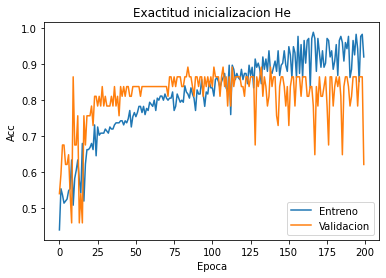

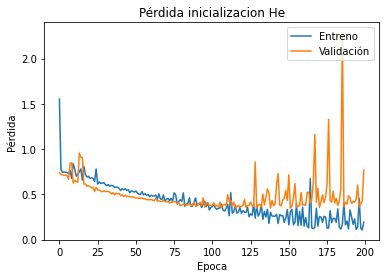

Inicio Init=He
Regularizer=L2:2020-09-19 10:29:44.603554
Epoca= 123 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 10:32:42.517910


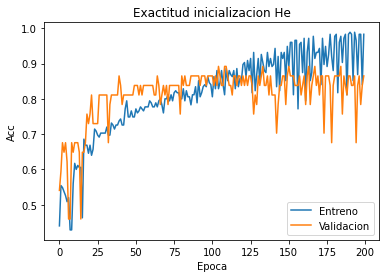

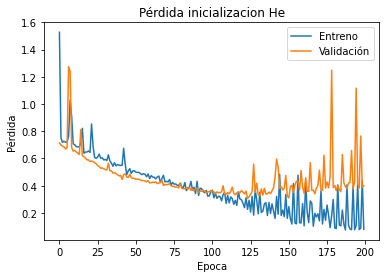

Inicio Init=norm
Regularizer=L1:2020-09-19 10:32:42.954743
Epoca= 196 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 10:36:21.394329


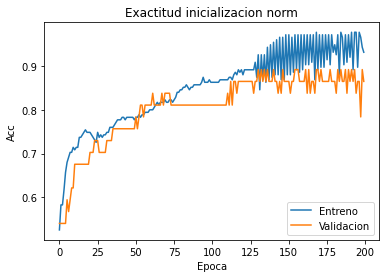

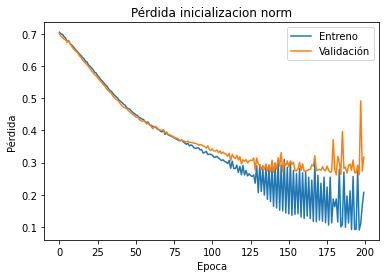

Inicio Init=norm
Regularizer=L2:2020-09-19 10:36:21.843128
Epoca= 173 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 10:39:47.452963


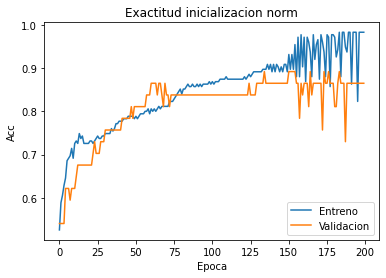

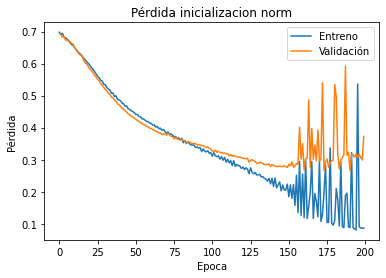

+--------+--------+--------+-------+------+-------------+
| Exac_E | Exac_V | Exac_P | Epoca | Init | Regularizer |
+--------+--------+--------+-------+------+-------------+
|  1.0   | 0.8649 | 0.8421 |  151  |  He  |      L1     |
|  1.0   | 0.8649 | 0.8421 |  123  |  He  |      L2     |
|  1.0   | 0.8649 | 0.8684 |  196  | norm |      L1     |
|  1.0   | 0.8919 | 0.8421 |  173  | norm |      L2     |
+--------+--------+--------+-------+------+-------------+


In [17]:

# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca", "Init", "Regularizer"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=200

# Definimos los parametros del RMSProp
rmsprop = keras.optimizers.RMSprop(lr=0.00008, rho=0.9)

# implementamos 2 repeticiones, una con inicializacion aleatoria Normal y otra con He
for i in range(4):
    if(i==0):
        model = Sequential.from_config(config_he_l1)
        init = "He"
        tiempo0 = datetime.datetime.now()
        regularizer = 'L1'
        print('Inicio Init=' +str(init))
        print('Regularizer=' +str(regularizer)+':' +str(tiempo0))
    elif(i==1):
        model = Sequential.from_config(config_he_l2)
        init = "He"
        tiempo0 = datetime.datetime.now()
        regularizer = 'L2'
        print('Inicio Init=' +str(init))
        print('Regularizer=' +str(regularizer)+':' +str(tiempo0))
    elif(i==2):
        model = Sequential.from_config(config_norm_l1)
        init = "norm"
        tiempo0 = datetime.datetime.now()
        regularizer = 'L1'
        print('Inicio Init=' +str(init))
        print('Regularizer=' +str(regularizer)+':' +str(tiempo0))
    elif(i==3):
        model = Sequential.from_config(config_norm_l2)
        init = "norm"
        tiempo0 = datetime.datetime.now()
        regularizer = 'L2'
        print('Inicio Init=' +str(init))
        print('Regularizer=' +str(regularizer)+':' +str(tiempo0))
        
    # Partimos los datos en entrenamiento y doble validación
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(X, Y.T, test_size = 0.3, random_state = 8)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = 8)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=rmsprop, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)  
  
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en la primera validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
           
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    pathr =('Regulmodelo_redprofunda_initseed=1_part_seed=8_Init='+str(init)+'.h5')
    model.save(pathr) 
    err_p = loss_p
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0], init, regularizer])
    
    # Imprimimos el desempeño para cada inicializacion y el tiempo en completar las iteraciones
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    tiempo1 = datetime.datetime.now()
    print('Fin Init= ' +str(init)+':' +str(tiempo1))
    
    # Graficamos el desempeño del modelo
    plt.figure(1)
    plt.plot(history.history['accuracy'])  
    plt.plot(history.history['val_accuracy'])  
    plt.title('Exactitud inicializacion ' +str(init))  
    plt.ylabel('Acc')  
    plt.xlabel('Epoca')  
    plt.legend(['Entreno', 'Validacion'], loc='lower right')
    plt.show()

    plt.figure(1) 
    plt.plot(history.history['loss'])  
    plt.plot(history.history['val_loss'])  
    plt.title('Pérdida inicializacion ' +str(init))  
    plt.ylabel('Pérdida')  
    plt.xlabel('Epoca')  
    plt.legend(['Entreno', 'Validación'], loc='upper right')  
    plt.show()

print(x)

Al aplicar una regularización en la capa de salida de tipo:

$$L(f(x_i),y_i)=\sum_{i=1}^{n} l(f(x_i),y_i)+\lambda R(f)$$

Con $R(f)$ la función $L1$ (Regularización Lasso) o $L2$ (Regularización Ridge); se puede observar que para la inicialización He se reduce considerablemente el número de épocas; computancionalmente el costo se reduce entre un 10% y 20%. Sin abandonar la capacidad de predicción del modelo. 

Este se convertiría en otro parámetro a optmizar ya que con diferentes valores de $\lambda$ los resultados podrían cambiar considerablemente.

## Ejercicio 2.2

Revise los métodos de inicialización, el procedimiento de optimización, la arquitectura de la red y/o las funciones de activación, e intente mejorar los resultados que acabamos de obtener. 

In [26]:
Mto_Inicial = {'He':keras.initializers.he_normal(seed=1),
                'Xav':keras.initializers.GlorotNormal(seed=1),
                'Ortog':keras.initializers.Orthogonal(gain=1.0, seed=None),
                'norm':keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)}
Optimizador = {'SGD':SGD(lr=0.01, momentum=0.001),
                'RMSprop':keras.optimizers.RMSprop(lr=0.00008, rho=0.9)}
Neuronas = {0:[700,400,100,50,15],
            1:[128,64,32,16,8],
            2:[1000,500,500,250,100]}
Fun_Activacion = {0:'relu',
                    1:'tanh',
                     2:'selu',
                    3:'softmax'}
Regula = {'L1':keras.regularizers.l1(0.01),
         'L2':keras.regularizers.l2(0.01)}
"""
i=0
k=0
list(Mto_Inicial.keys())[0]
Neuronas[k][0]
"""


'\ni=0\nk=0\nlist(Mto_Inicial.keys())[0]\nNeuronas[k][0]\n'

Inicio Init=He
Optim=SGD
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 11:15:32.744155
Epoca= 130 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:16:45.313298


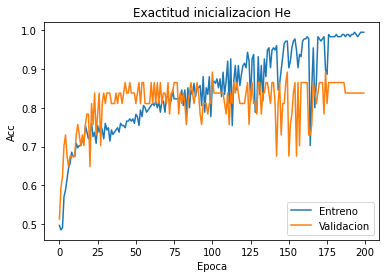

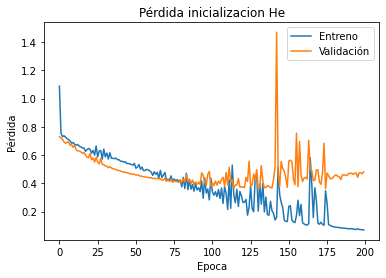

Inicio Init=He
Optim=SGD
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 11:16:45.739202
Epoca= 116 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:17:57.904036


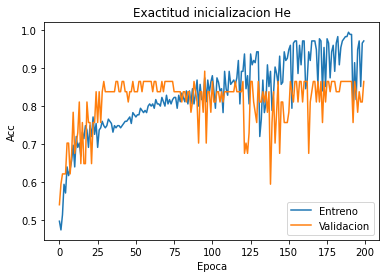

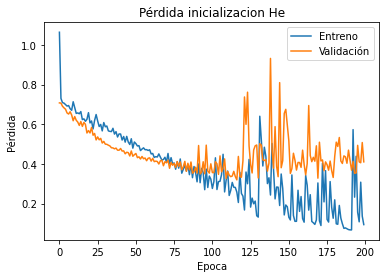

Inicio Init=He
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 11:17:58.465559
Epoca= 194 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= He:2020-09-19 11:19:27.447769


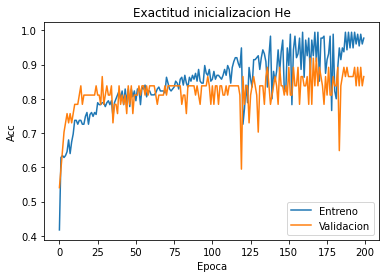

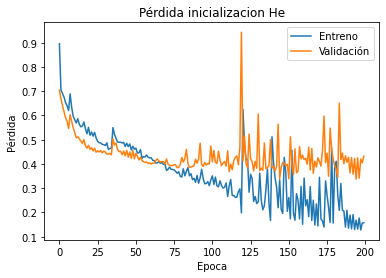

Inicio Init=He
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 11:19:27.878583
Epoca= 182 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= He:2020-09-19 11:20:57.133629


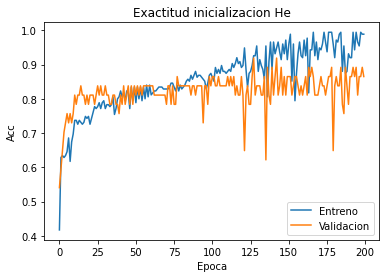

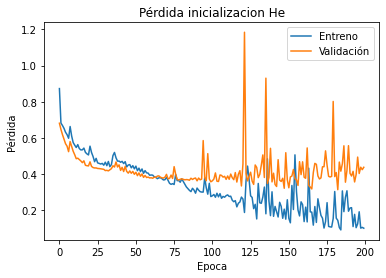

Inicio Init=He
Optim=SGD
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 11:20:57.498653
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 11:22:30.086728


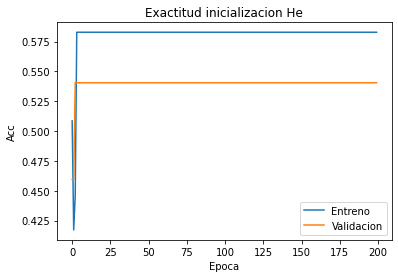

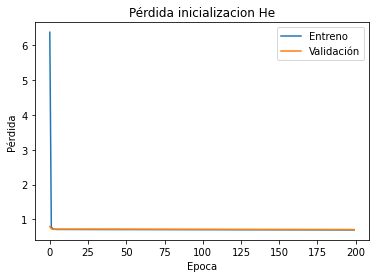

Inicio Init=He
Optim=SGD
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 11:22:30.446790
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 11:24:02.646678


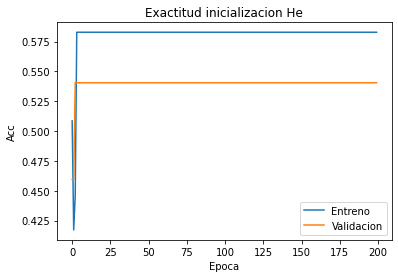

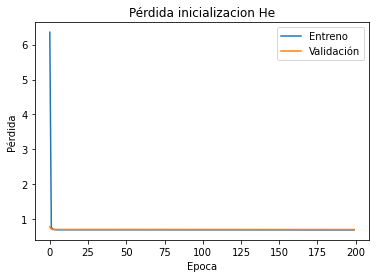

Inicio Init=He
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 11:24:02.994773
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 11:25:35.228056


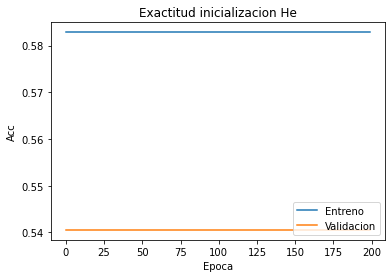

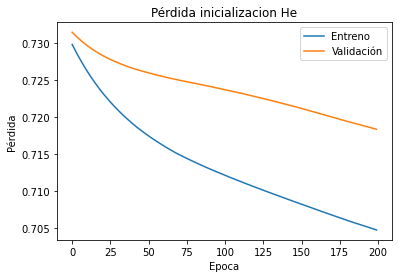

Inicio Init=He
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 11:25:35.646973
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 11:27:09.750395


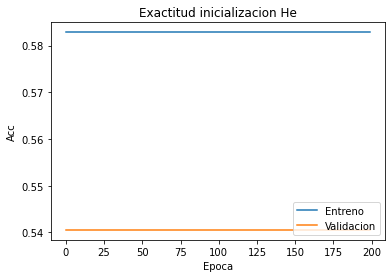

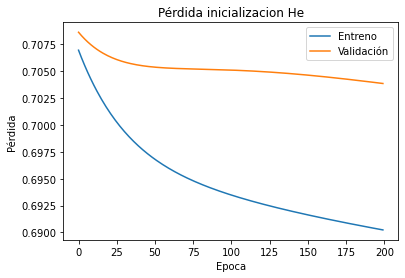

Inicio Init=He
Optim=SGD
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 11:27:10.046603
Epoca= 167 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:27:35.515064


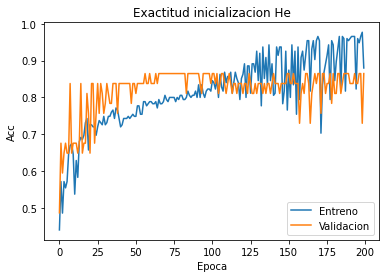

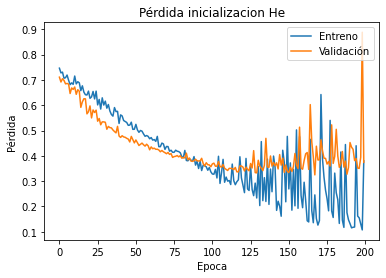

Inicio Init=He
Optim=SGD
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 11:27:35.792322
Epoca= 162 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:28:01.520973


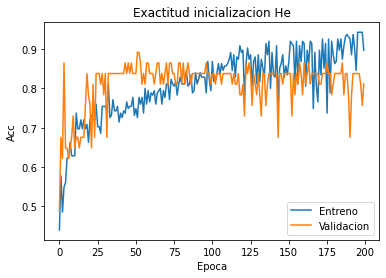

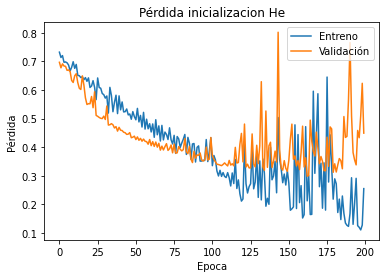

Inicio Init=He
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 11:28:01.816222
Epoca= 168 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:28:27.100833


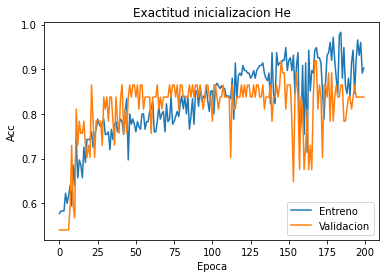

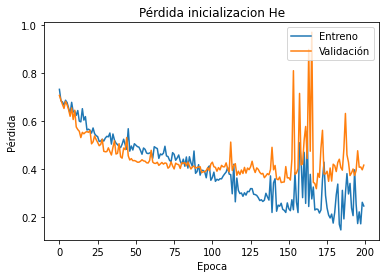

Inicio Init=He
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 11:28:27.396512
Epoca= 165 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:28:53.279754


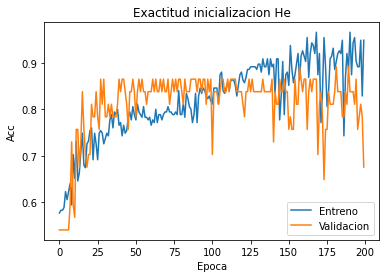

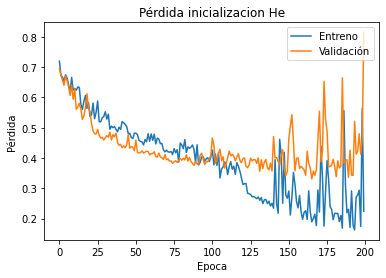

Inicio Init=He
Optim=SGD
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 11:28:53.552066
Epoca= 121 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= He:2020-09-19 11:29:16.769930


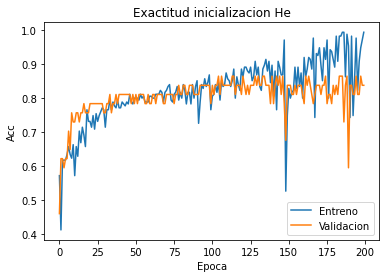

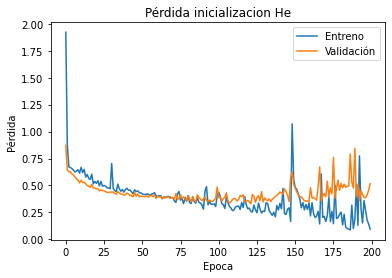

Inicio Init=He
Optim=SGD
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 11:29:17.071125
Epoca= 139 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= He:2020-09-19 11:29:41.422034


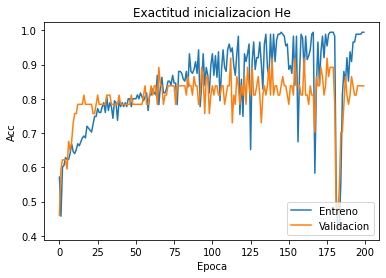

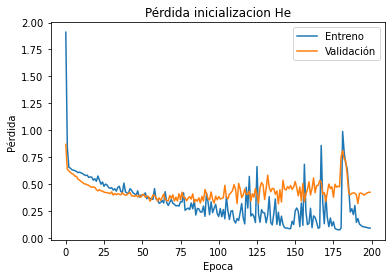

Inicio Init=He
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 11:29:41.710263
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 11:30:11.545489


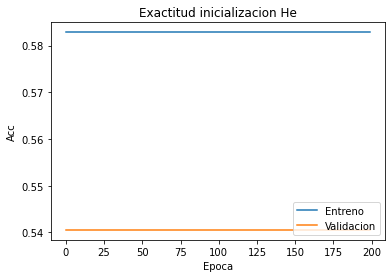

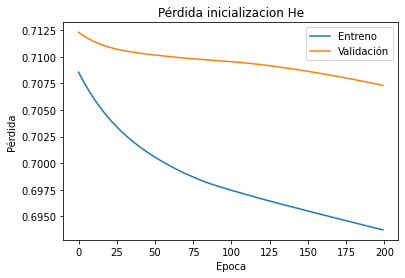

Inicio Init=He
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 11:30:11.862641
Epoca= 28 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 11:30:30.124184


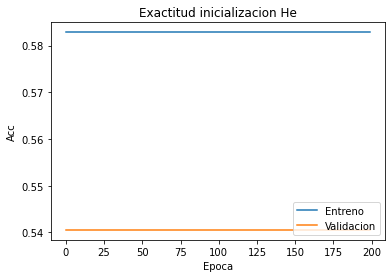

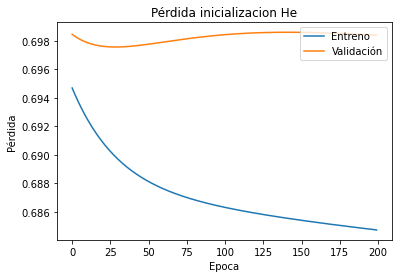

Inicio Init=He
Optim=SGD
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 11:30:30.549047
Epoca= 110 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:32:14.241282


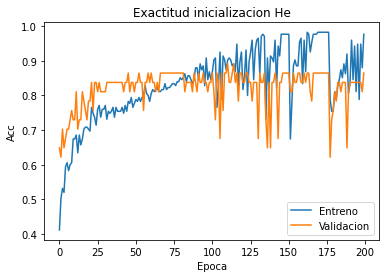

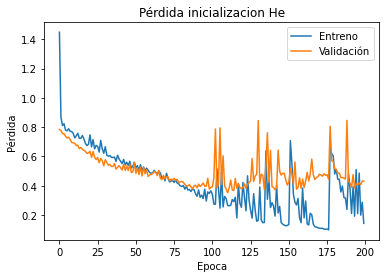

Inicio Init=He
Optim=SGD
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 11:32:14.902514
Epoca= 133 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:34:05.880109


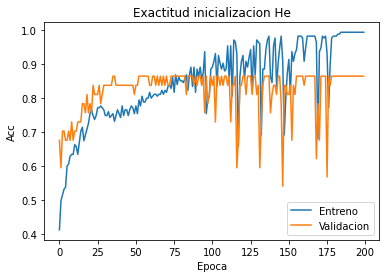

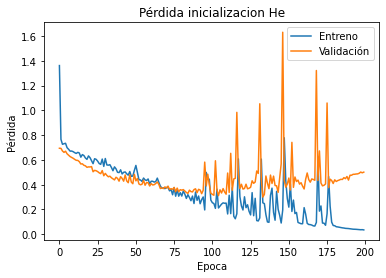

Inicio Init=He
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 11:34:06.389771
Epoca= 158 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= He:2020-09-19 11:36:04.980852


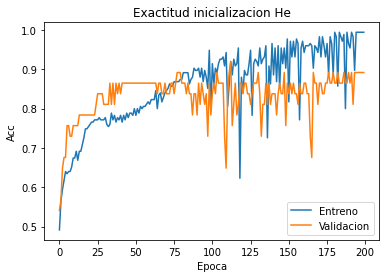

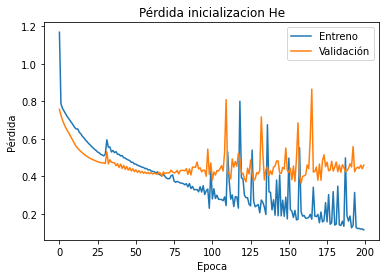

Inicio Init=He
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 11:36:05.381755
Epoca= 140 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= He:2020-09-19 11:38:00.332867


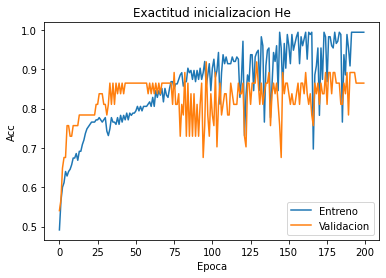

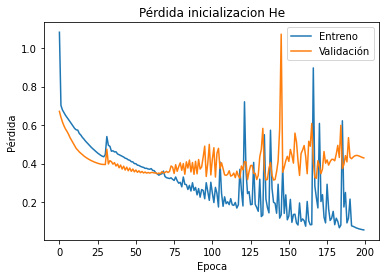

Inicio Init=He
Optim=SGD
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 11:38:00.734792
Epoca= 194 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:40:11.628759


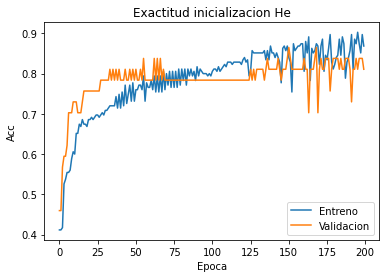

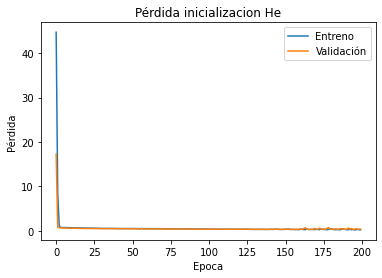

Inicio Init=He
Optim=SGD
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 11:40:12.151031
Epoca= 197 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= He:2020-09-19 11:42:25.267446


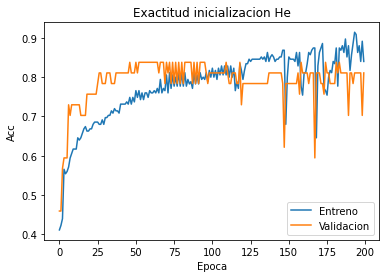

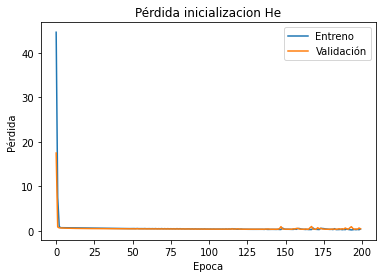

Inicio Init=He
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 11:42:25.696997
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 11:44:40.995970


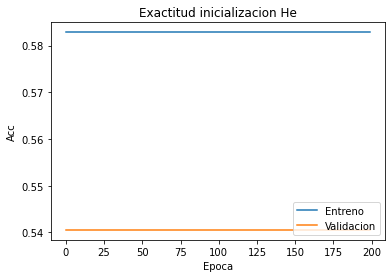

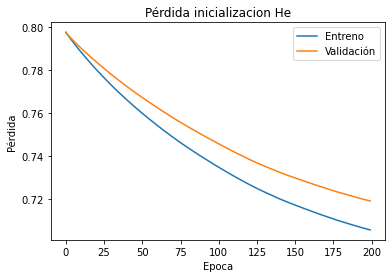

Inicio Init=He
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 11:44:41.400886
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 11:46:57.111800


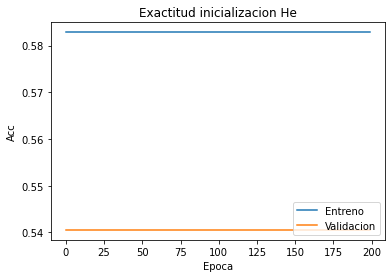

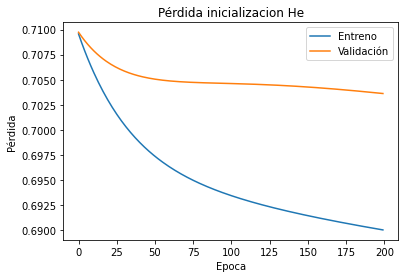

Inicio Init=He
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 11:46:57.568578
Epoca= 151 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:50:08.289723


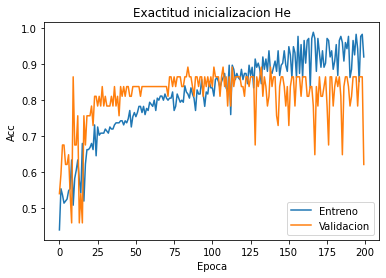

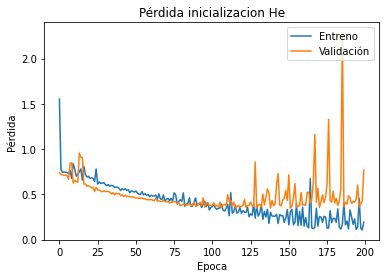

Inicio Init=He
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 11:50:08.702618
Epoca= 123 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 11:53:03.890756


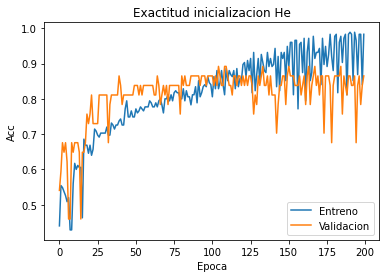

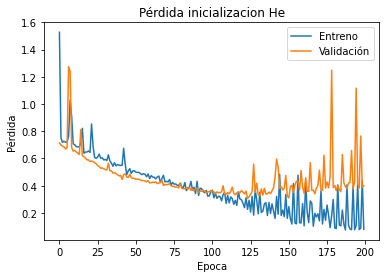

Inicio Init=He
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 11:53:04.313661
Epoca= 135 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643
Fin Init= He:2020-09-19 11:56:07.732267


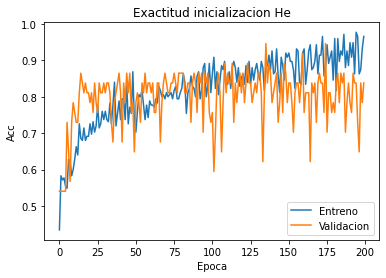

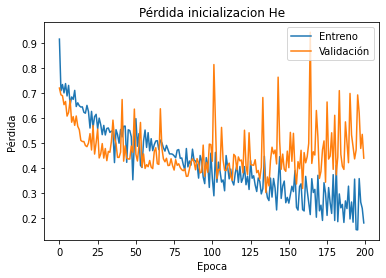

Inicio Init=He
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 11:56:08.100283
Epoca= 128 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643
Fin Init= He:2020-09-19 11:59:08.781272


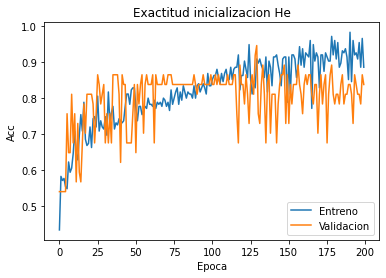

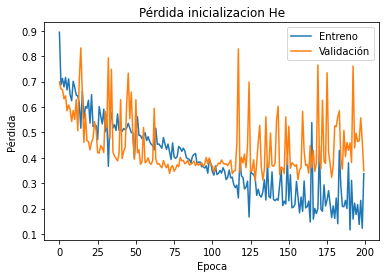

Inicio Init=He
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 11:59:09.199155
Epoca= 125 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= He:2020-09-19 12:02:11.455003


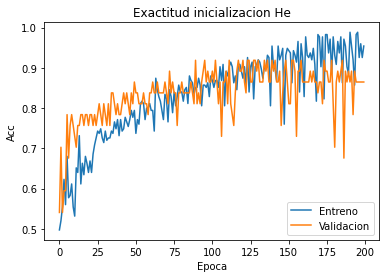

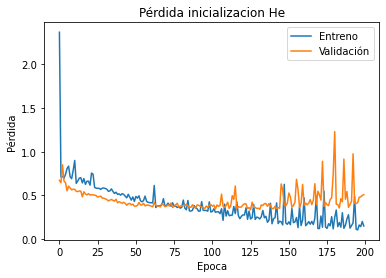

Inicio Init=He
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 12:02:11.982617
Epoca= 114 , accu_v1=0.8108108043670654 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 12:05:08.730630


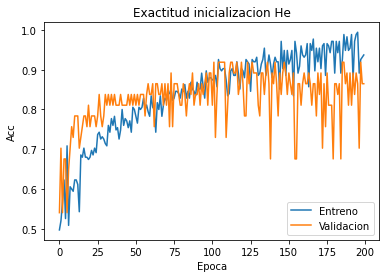

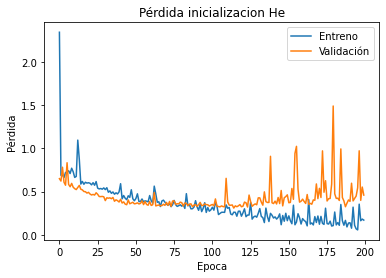

Inicio Init=He
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 12:05:09.082715
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 12:08:51.153350


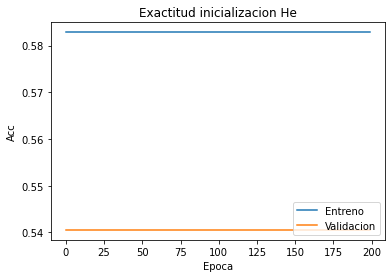

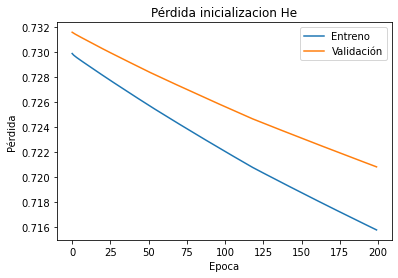

Inicio Init=He
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 12:08:51.691953
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 12:12:32.737057


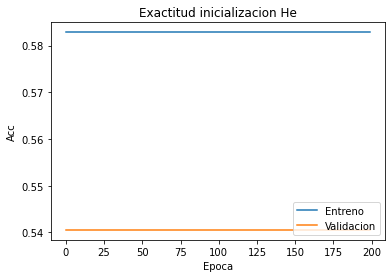

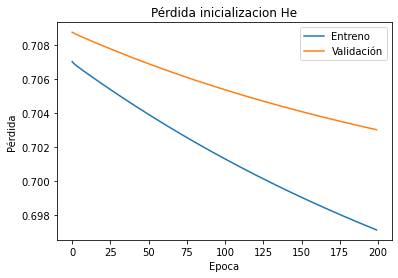

Inicio Init=He
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 12:12:33.059239
Epoca= 176 , accu_v1=0.8918918967247009 , accu_v2=0.8157894611358643
Fin Init= He:2020-09-19 12:13:21.328939


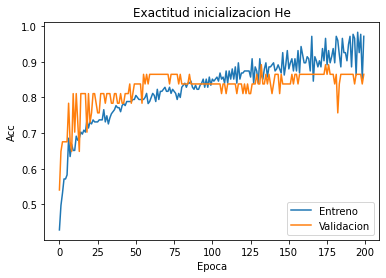

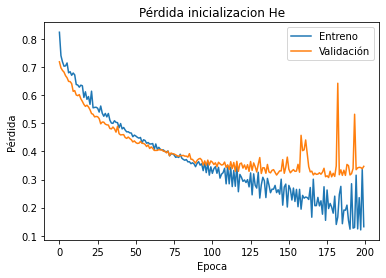

Inicio Init=He
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 12:13:21.640196
Epoca= 191 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 12:14:12.144797


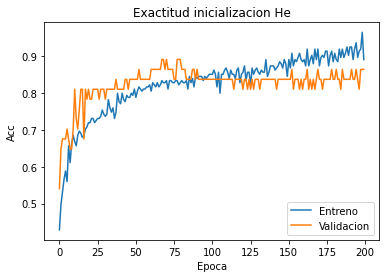

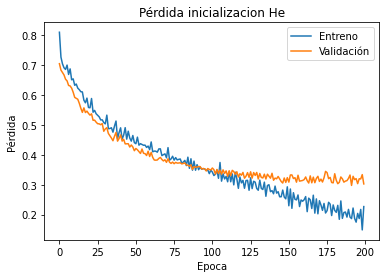

Inicio Init=He
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 12:14:12.422098
Epoca= 140 , accu_v1=0.7837837934494019 , accu_v2=0.8157894611358643
Fin Init= He:2020-09-19 12:14:56.764792


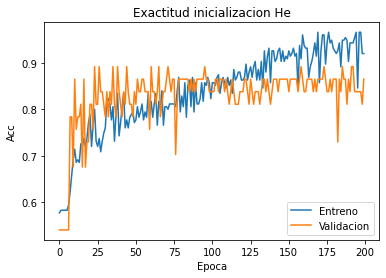

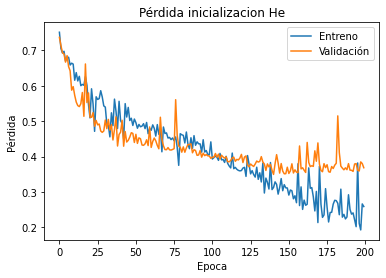

Inicio Init=He
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 12:14:57.069015
Epoca= 189 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643
Fin Init= He:2020-09-19 12:15:47.330734


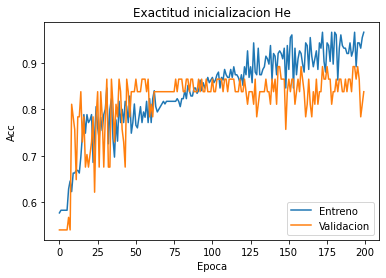

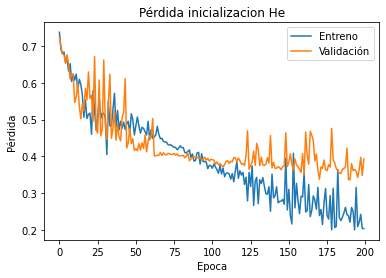

Inicio Init=He
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 12:15:47.598019
Epoca= 150 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 12:16:32.793619


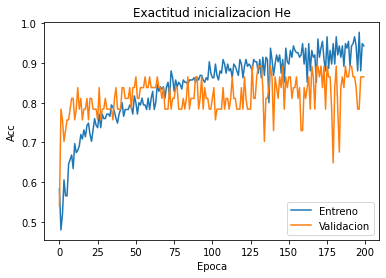

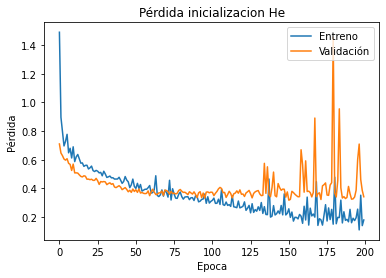

Inicio Init=He
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 12:16:33.111808
Epoca= 149 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 12:17:18.337411


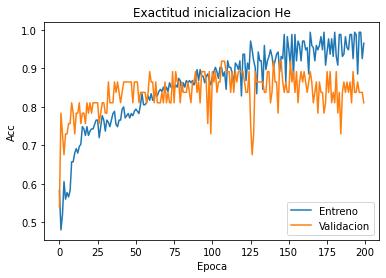

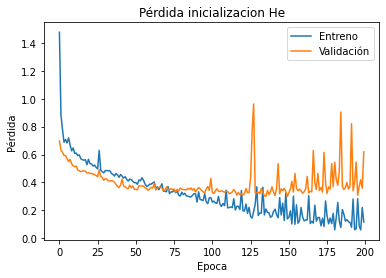

Inicio Init=He
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 12:17:18.634619
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 12:18:09.909208


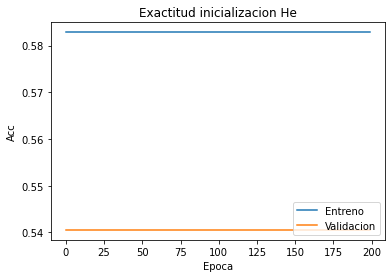

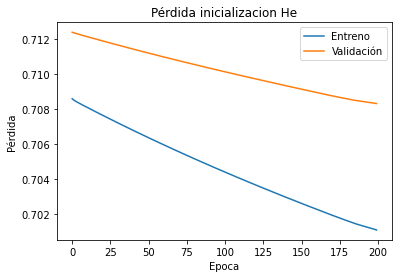

Inicio Init=He
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 12:18:10.201428
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 12:19:01.590183


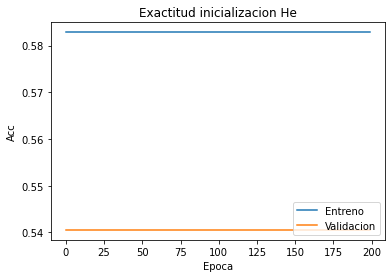

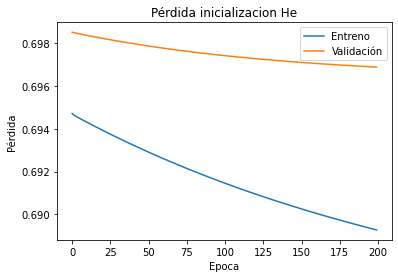

Inicio Init=He
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 12:19:01.993105
Epoca= 162 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 12:23:43.124151


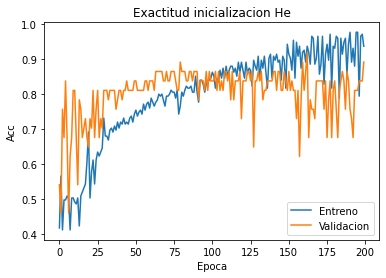

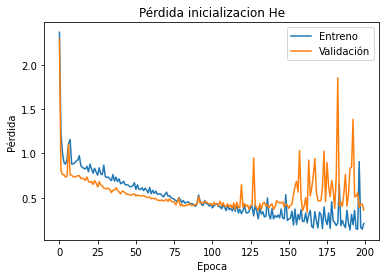

Inicio Init=He
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 12:23:43.653734
Epoca= 142 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 12:28:11.639766


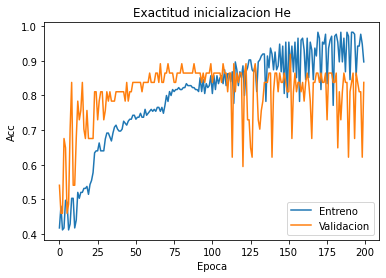

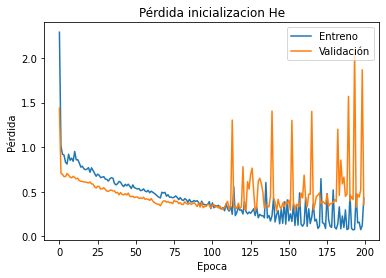

Inicio Init=He
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 12:28:12.171344
Epoca= 134 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643
Fin Init= He:2020-09-19 12:32:39.493084


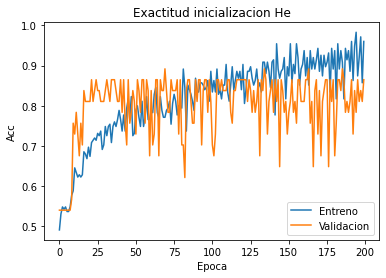

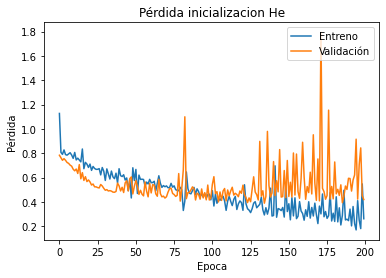

Inicio Init=He
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 12:32:39.927921
Epoca= 144 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= He:2020-09-19 12:37:14.010767


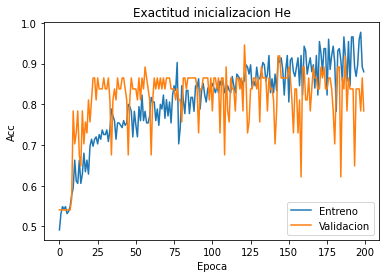

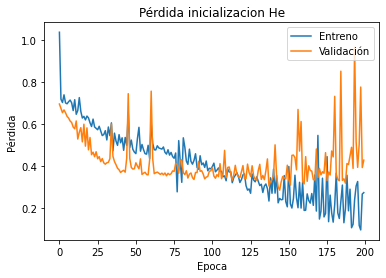

Inicio Init=He
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 12:37:14.426514
Epoca= 140 , accu_v1=0.837837815284729 , accu_v2=0.8684210777282715
Fin Init= He:2020-09-19 12:41:48.693939


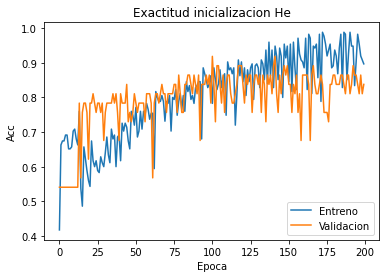

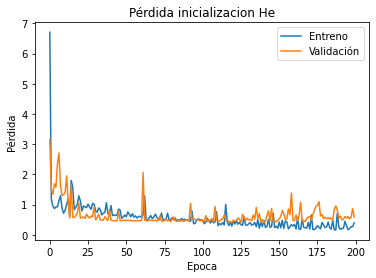

Inicio Init=He
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 12:41:49.210601
Epoca= 112 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= He:2020-09-19 12:46:00.731760


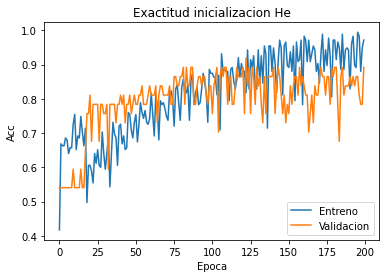

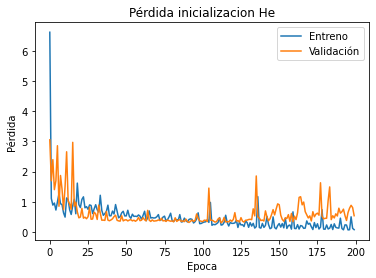

Inicio Init=He
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 12:46:01.177567
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 12:51:23.632763


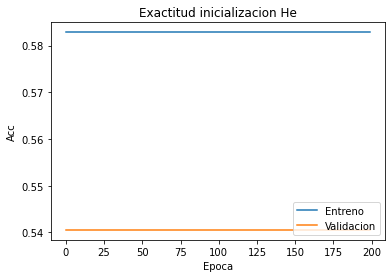

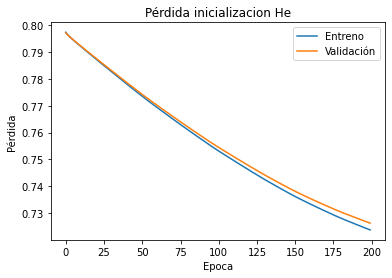

Inicio Init=He
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 12:51:24.154562
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= He:2020-09-19 12:56:42.671785


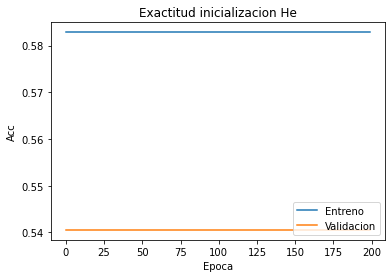

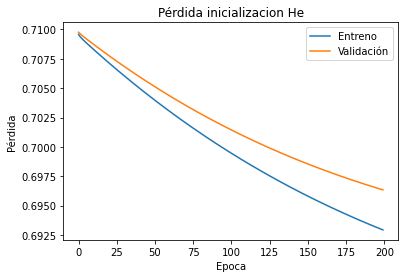

Inicio Init=Xav
Optim=SGD
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 12:56:43.051767
Epoca= 110 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 12:57:58.469374


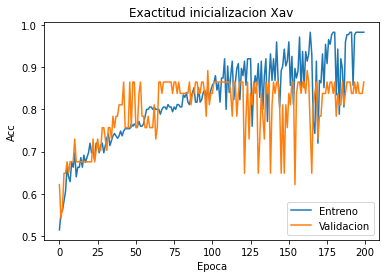

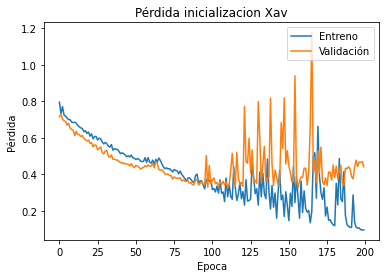

Inicio Init=Xav
Optim=SGD
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 12:57:58.823450
Epoca= 126 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 12:59:18.805032


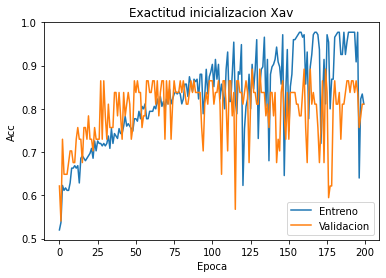

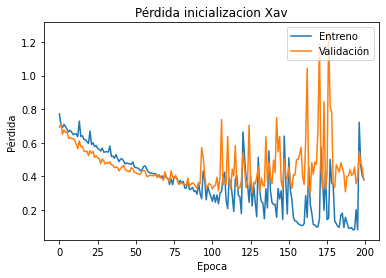

Inicio Init=Xav
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 12:59:19.164113
Epoca= 125 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 13:00:39.566234


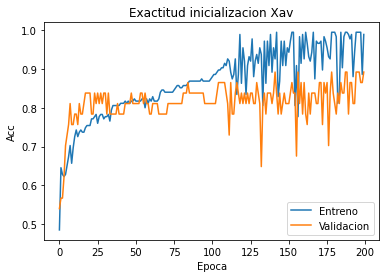

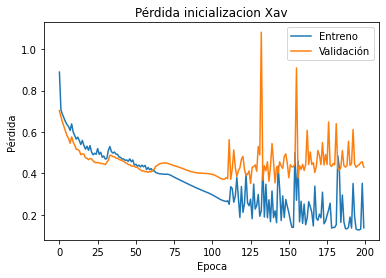

Inicio Init=Xav
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 13:00:39.926270
Epoca= 199 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 13:02:18.010756


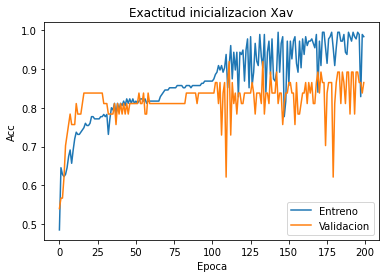

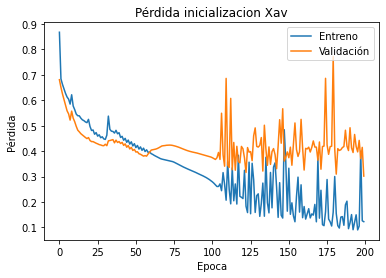

Inicio Init=Xav
Optim=SGD
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 13:02:18.381789
Epoca= 198 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 13:03:57.774406


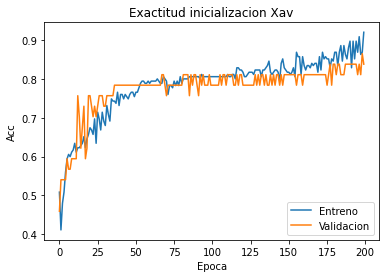

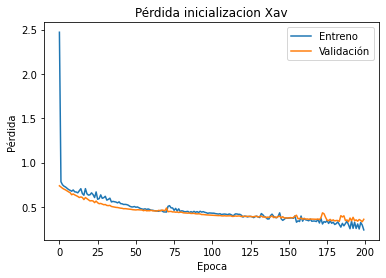

Inicio Init=Xav
Optim=SGD
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 13:03:58.184308
Epoca= 182 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 13:05:32.424316


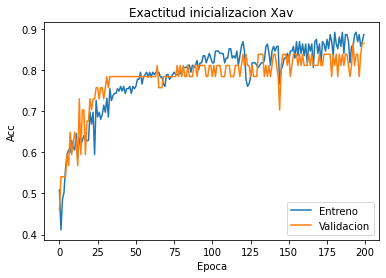

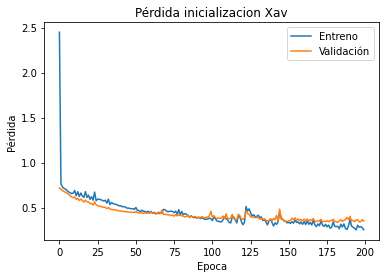

Inicio Init=Xav
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 13:05:32.836214
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 13:07:11.403589


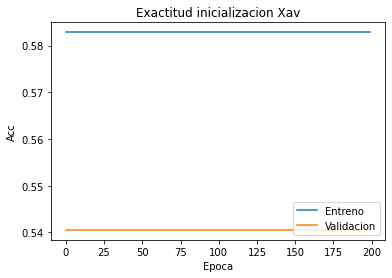

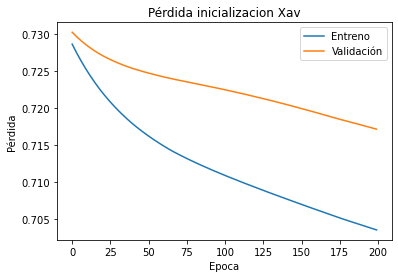

Inicio Init=Xav
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 13:07:11.805549
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 13:08:51.254255


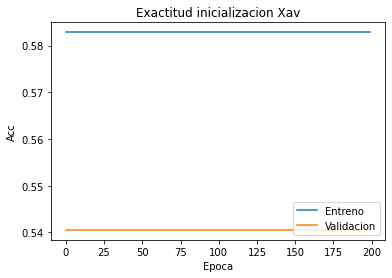

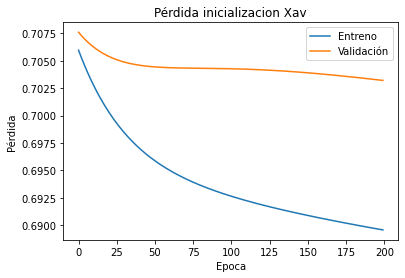

Inicio Init=Xav
Optim=SGD
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 13:08:51.538496
Epoca= 143 , accu_v1=0.8108108043670654 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:09:21.491242


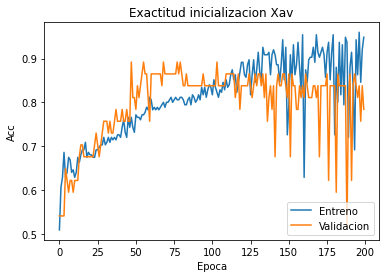

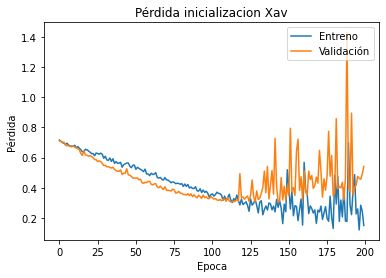

Inicio Init=Xav
Optim=SGD
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 13:09:21.776480
Epoca= 156 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:09:52.480333


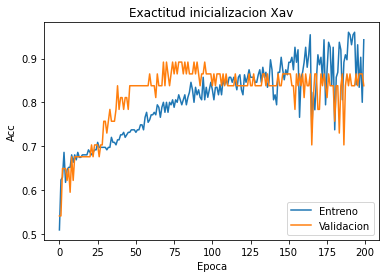

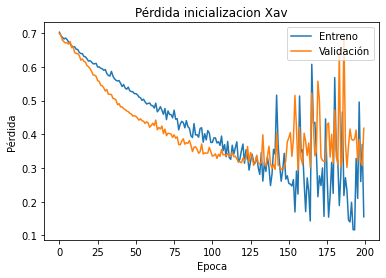

Inicio Init=Xav
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 13:09:52.786513
Epoca= 192 , accu_v1=0.837837815284729 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 13:10:25.613916


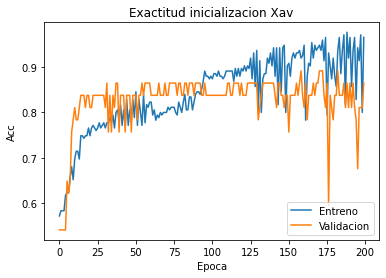

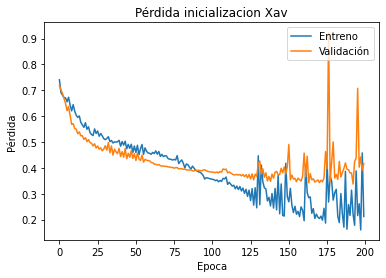

Inicio Init=Xav
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 13:10:25.891174
Epoca= 195 , accu_v1=0.837837815284729 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 13:10:57.940901


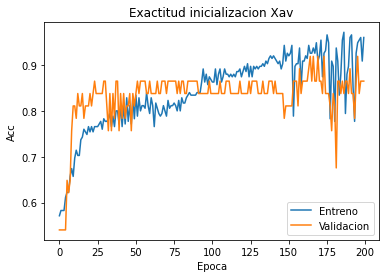

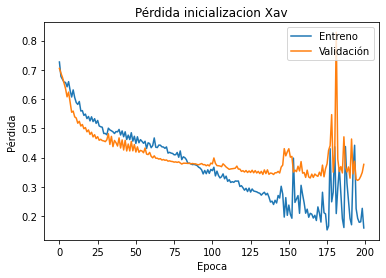

Inicio Init=Xav
Optim=SGD
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 13:10:58.217179
Epoca= 111 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:11:25.829334


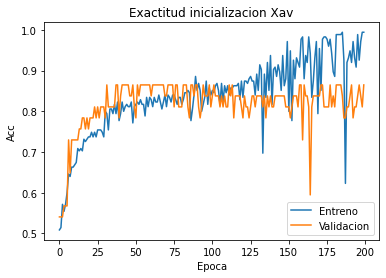

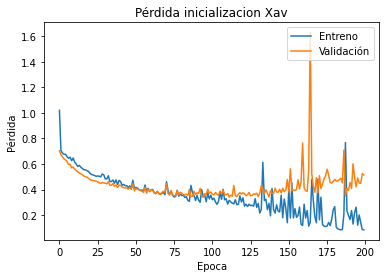

Inicio Init=Xav
Optim=SGD
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 13:11:26.132524
Epoca= 151 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:11:56.999001


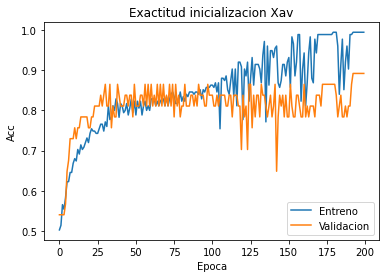

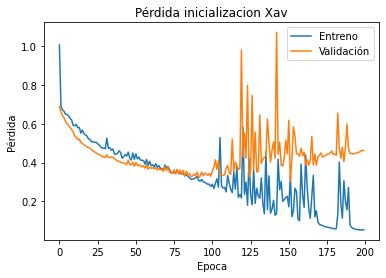

Inicio Init=Xav
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 13:11:57.291257
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 13:12:29.763671


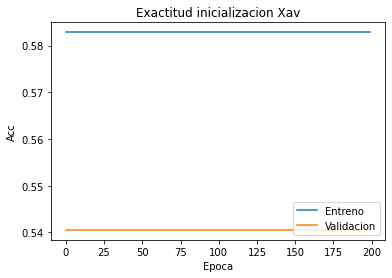

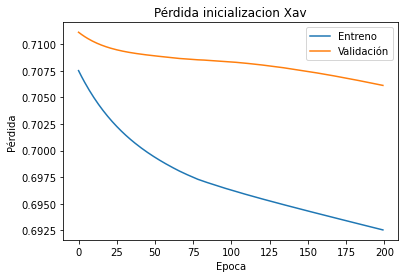

Inicio Init=Xav
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 13:12:30.073880
Epoca= 28 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 13:12:53.556747


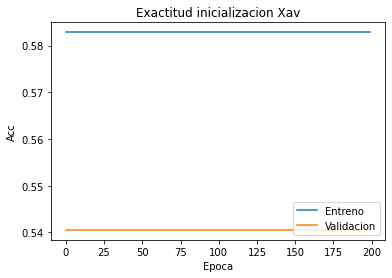

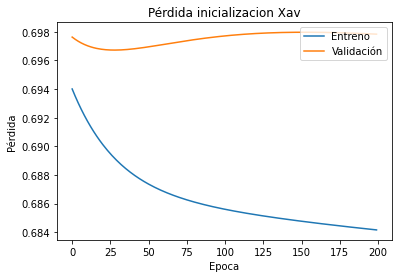

Inicio Init=Xav
Optim=SGD
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 13:12:53.975626
Epoca= 123 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:14:46.713535


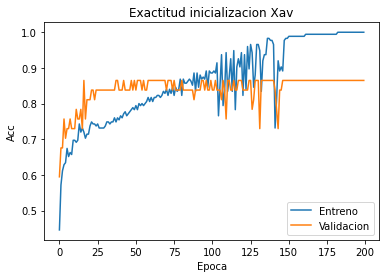

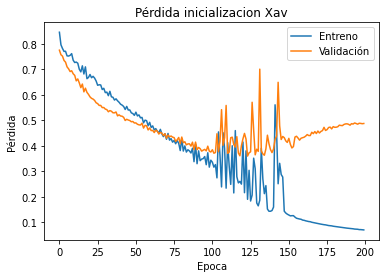

Inicio Init=Xav
Optim=SGD
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 13:14:47.130421
Epoca= 116 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:16:39.586982


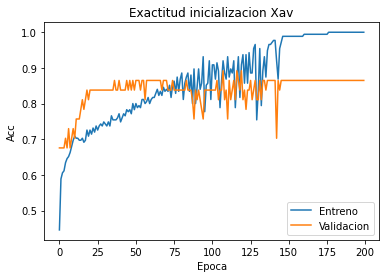

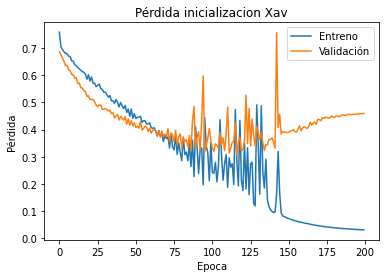

Inicio Init=Xav
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 13:16:40.003906
Epoca= 119 , accu_v1=0.837837815284729 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 13:18:36.699611


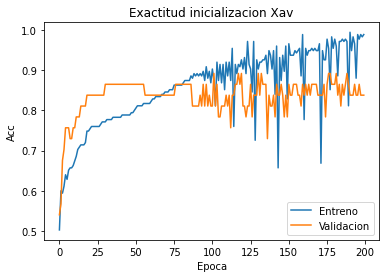

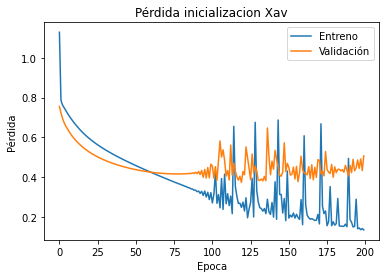

Inicio Init=Xav
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 13:18:37.200238
Epoca= 124 , accu_v1=0.837837815284729 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 13:20:35.815834


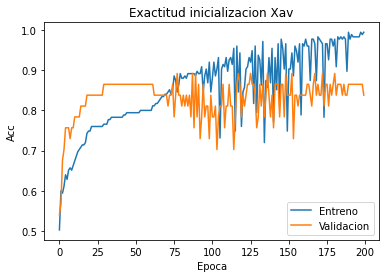

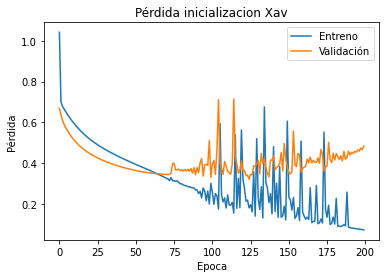

Inicio Init=Xav
Optim=SGD
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 13:20:36.215911
Epoca= 164 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 13:22:48.621764


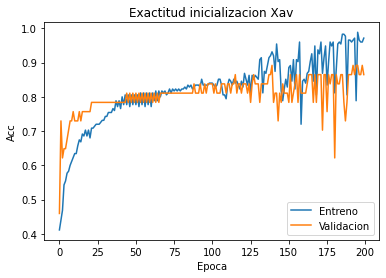

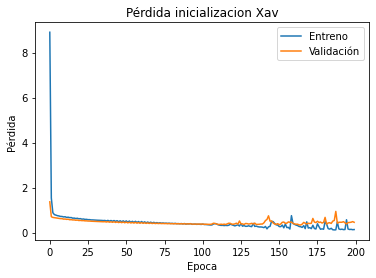

Inicio Init=Xav
Optim=SGD
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 13:22:49.026681
Epoca= 152 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 13:24:54.937834


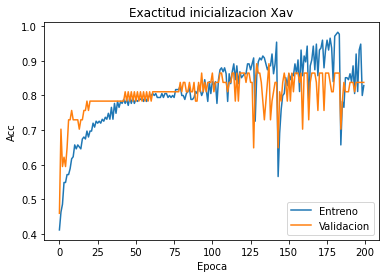

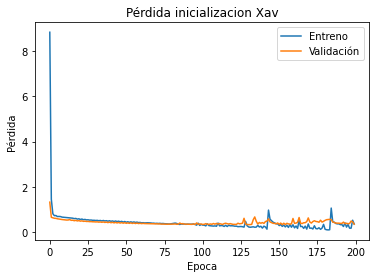

Inicio Init=Xav
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 13:24:55.339758
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 13:27:21.686164


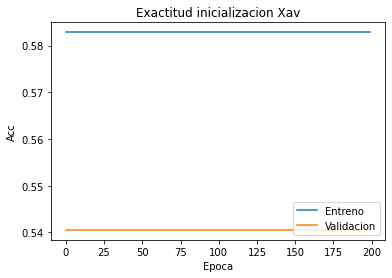

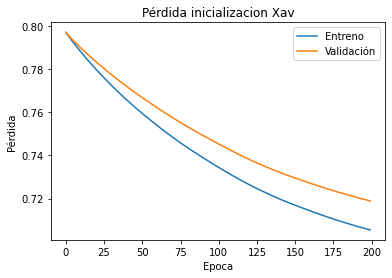

Inicio Init=Xav
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 13:27:22.089086
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 13:29:47.282870


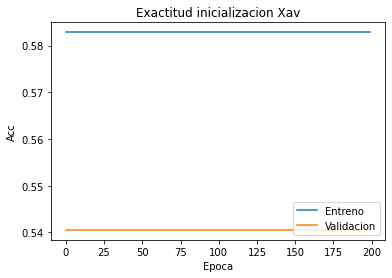

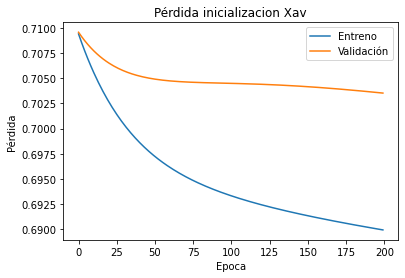

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 13:29:47.685792
Epoca= 181 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643
Fin Init= Xav:2020-09-19 13:33:25.714307


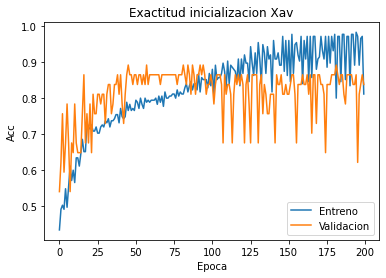

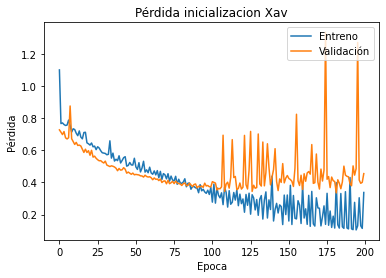

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 13:33:26.080354
Epoca= 159 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:36:53.545441


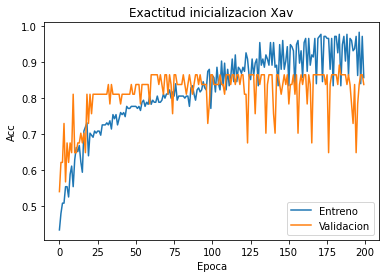

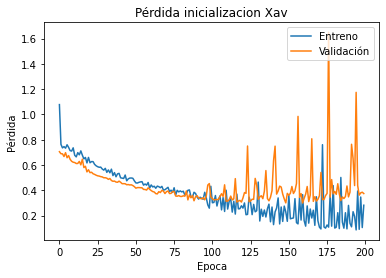

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 13:36:53.912481
Epoca= 187 , accu_v1=0.7027027010917664 , accu_v2=0.5526315569877625
Fin Init= Xav:2020-09-19 13:40:35.500588


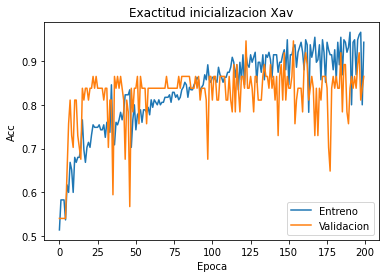

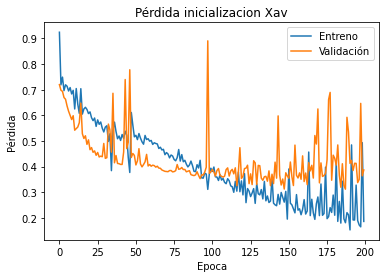

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 13:40:35.865645
Epoca= 136 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:43:49.668461


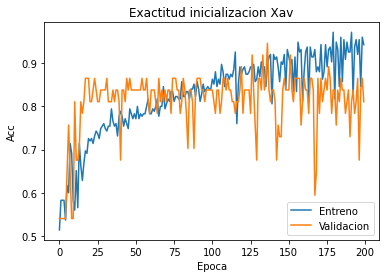

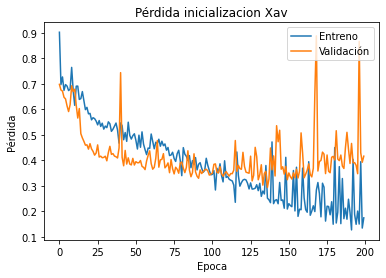

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 13:43:50.059415
Epoca= 94 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:46:44.600262


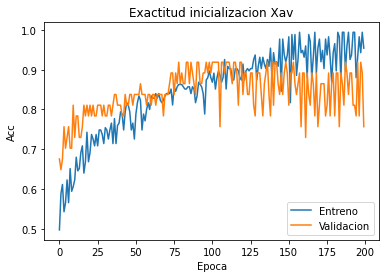

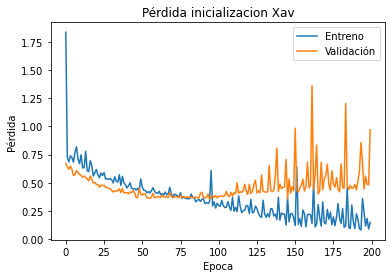

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 13:46:44.958322
Epoca= 119 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:49:53.333484


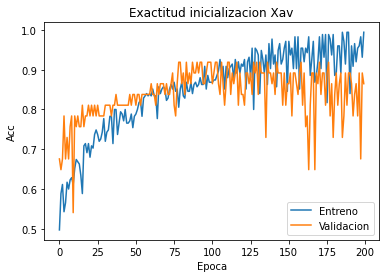

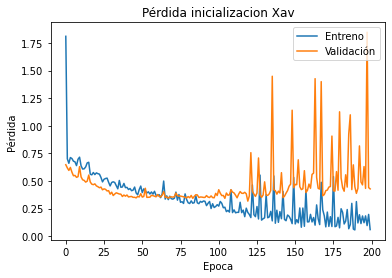

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 13:49:53.741394
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 13:53:45.951515


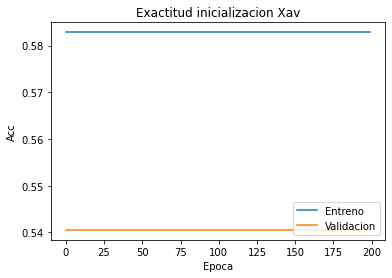

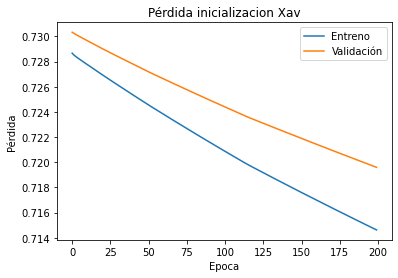

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 13:53:46.323520
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 13:57:37.890112


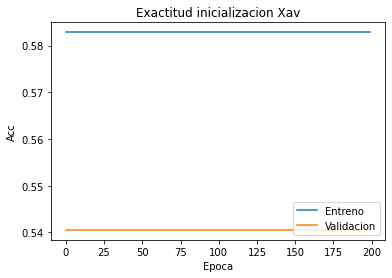

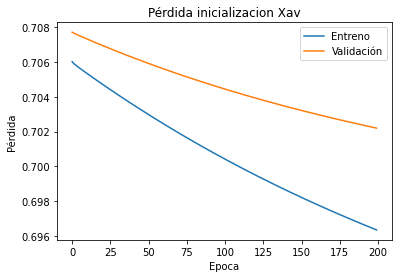

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 13:57:38.163382
Epoca= 199 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 13:58:38.212421


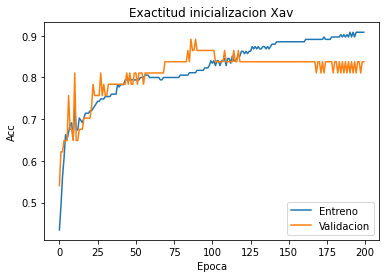

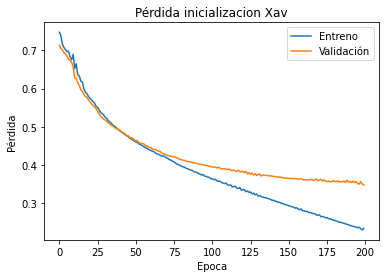

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 13:58:38.523590
Epoca= 199 , accu_v1=0.8918918967247009 , accu_v2=0.8157894611358643
Fin Init= Xav:2020-09-19 13:59:40.300972


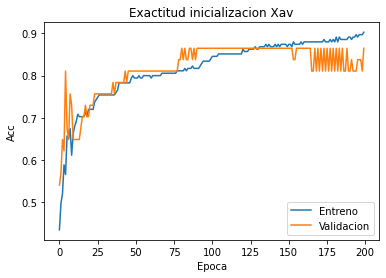

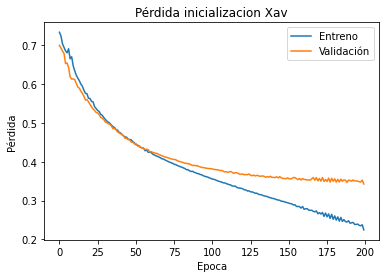

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 13:59:40.638106
Epoca= 191 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 14:00:39.217489


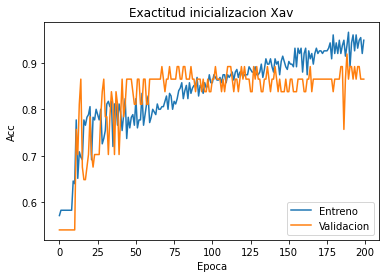

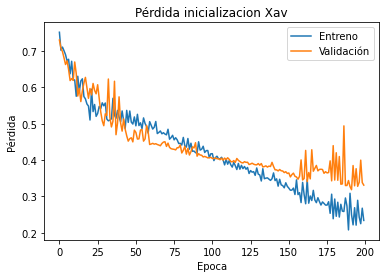

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 14:00:39.503723
Epoca= 197 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643
Fin Init= Xav:2020-09-19 14:01:39.390178


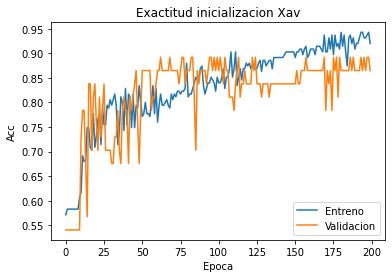

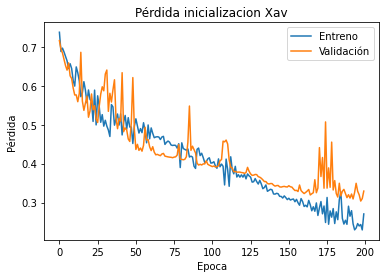

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 14:01:39.911785
Epoca= 127 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 14:02:31.584669


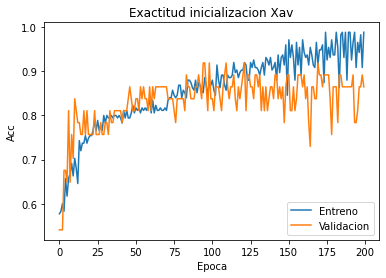

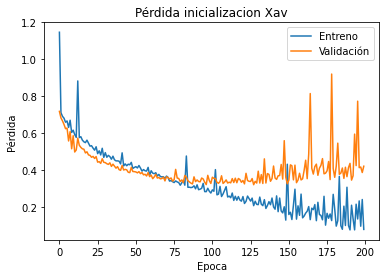

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 14:02:31.866913
Epoca= 168 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 14:03:27.117907


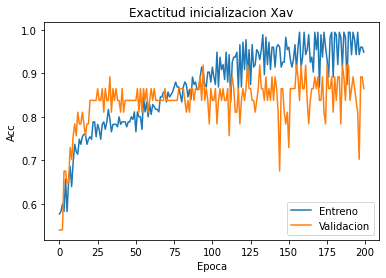

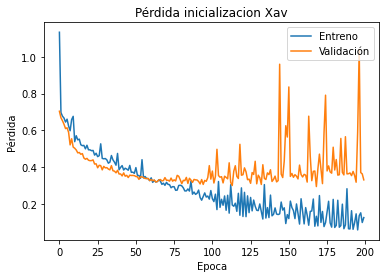

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 14:03:27.428122
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 14:04:27.178302


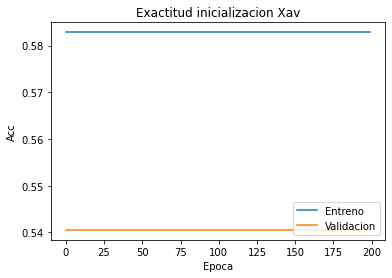

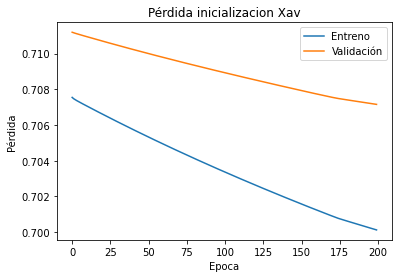

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 14:04:27.459551
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 14:05:24.623232


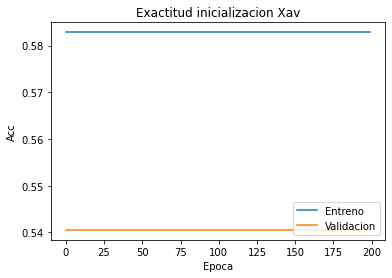

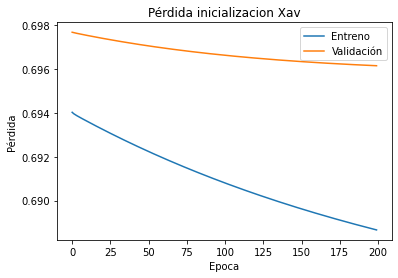

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 14:05:25.016181
Epoca= 133 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 14:09:54.203320


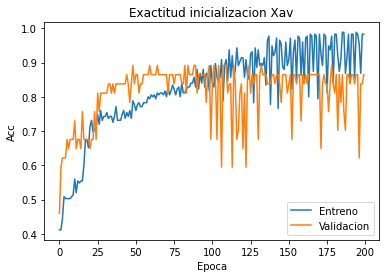

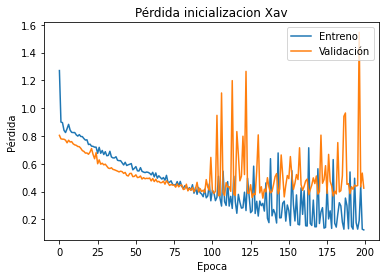

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 14:09:54.621203
Epoca= 115 , accu_v1=0.837837815284729 , accu_v2=0.6842105388641357
Fin Init= Xav:2020-09-19 14:14:09.955436


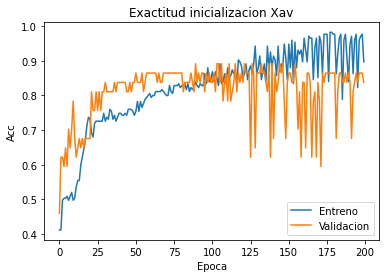

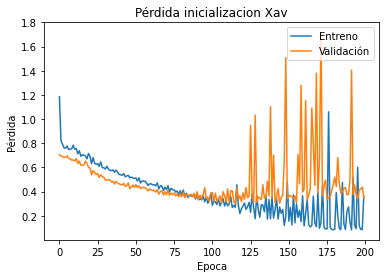

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 14:14:10.395259
Epoca= 155 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Xav:2020-09-19 14:18:58.620688


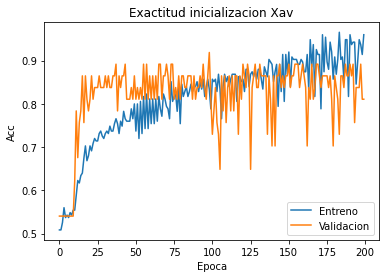

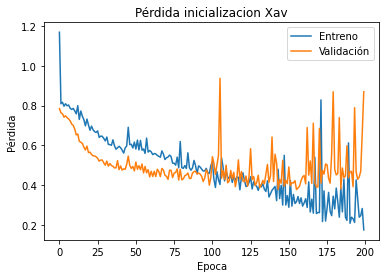

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 14:18:59.037573
Epoca= 126 , accu_v1=0.5405405163764954 , accu_v2=0.42105263471603394
Fin Init= Xav:2020-09-19 14:23:24.670640


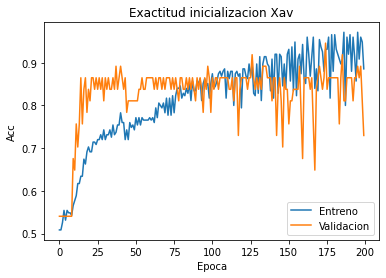

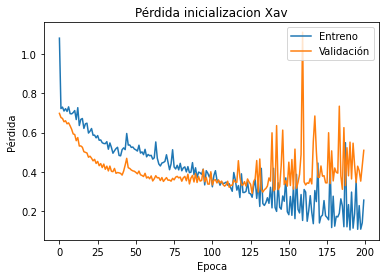

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 14:23:25.415647
Epoca= 113 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= Xav:2020-09-19 14:27:43.411512


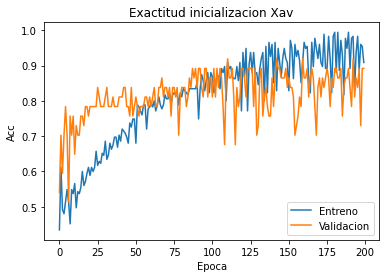

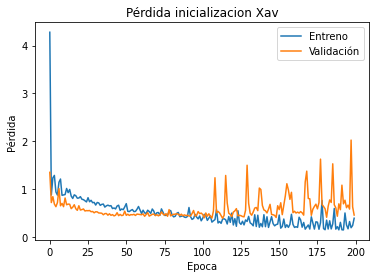

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 14:27:43.921149
Epoca= 103 , accu_v1=0.8648648858070374 , accu_v2=0.7894737124443054
Fin Init= Xav:2020-09-19 14:31:52.471766


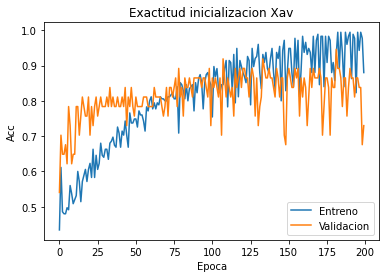

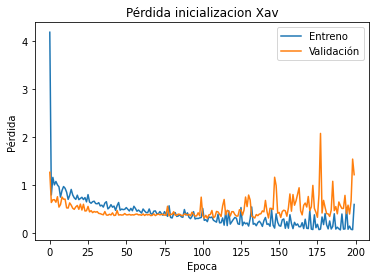

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 14:31:52.889640
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 14:37:18.253107


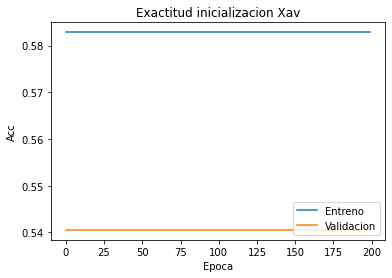

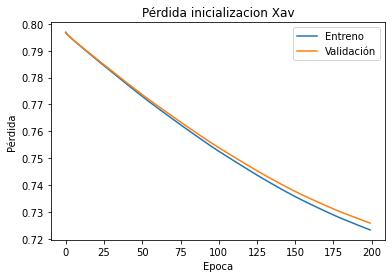

Inicio Init=Xav
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 14:37:18.753769
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Xav:2020-09-19 14:42:43.716934


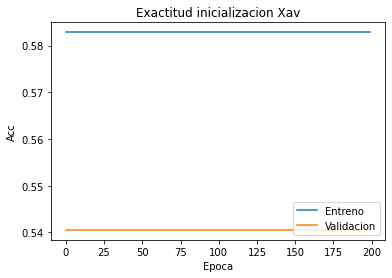

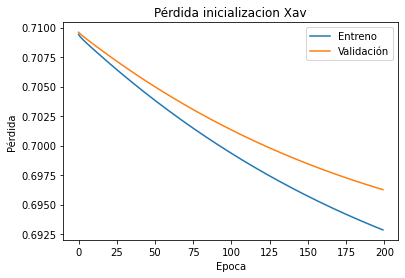

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 14:42:45.751494
Epoca= 188 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 14:44:27.770885


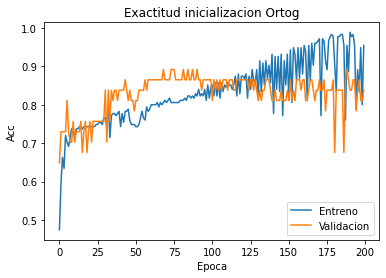

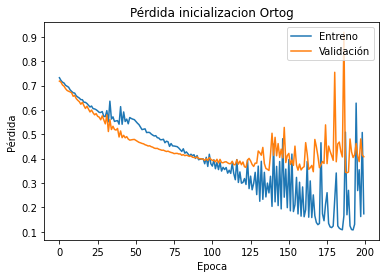

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 14:44:29.939994
Epoca= 167 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 14:46:08.303554


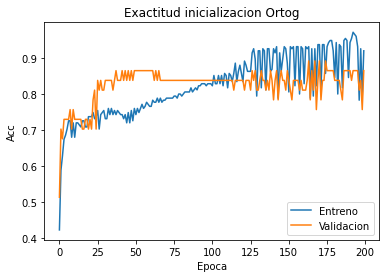

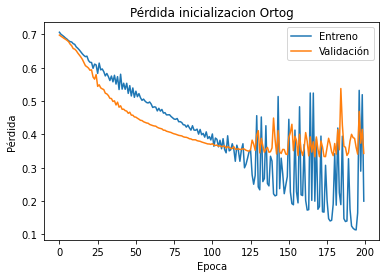

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 14:46:10.430903
Epoca= 175 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 14:47:49.317068


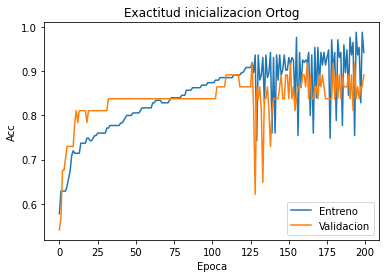

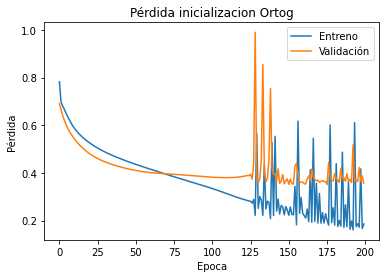

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 14:47:51.333676
Epoca= 193 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 14:49:35.063269


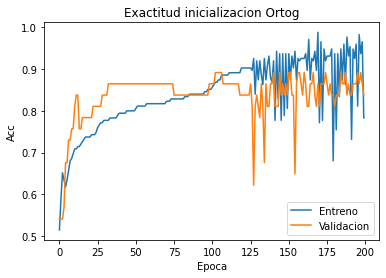

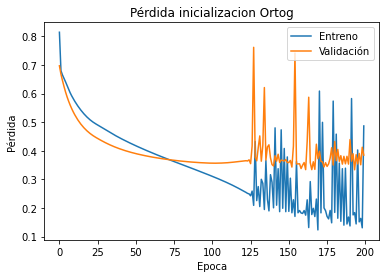

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 14:49:37.237455
Epoca= 164 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= Ortog:2020-09-19 14:51:16.224785


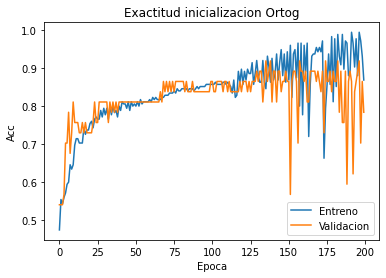

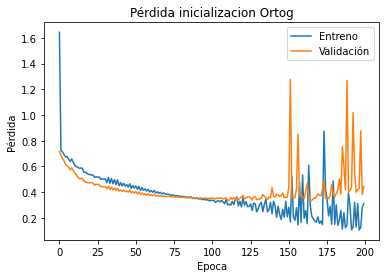

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 14:51:18.250392
Epoca= 106 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= Ortog:2020-09-19 14:52:42.463951


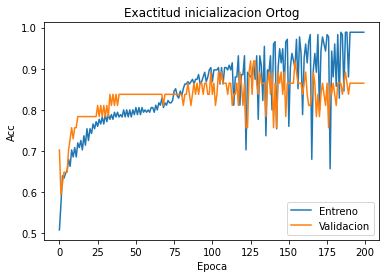

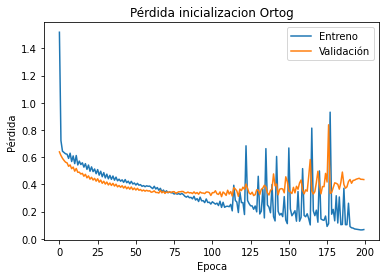

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 14:52:44.634185
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 14:54:35.769687


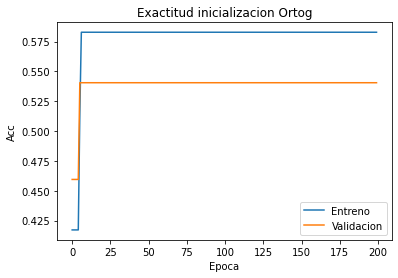

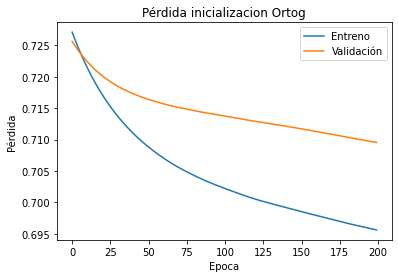

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 14:54:37.944870
Epoca= 53 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 14:55:50.860858


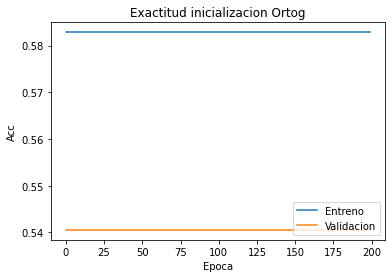

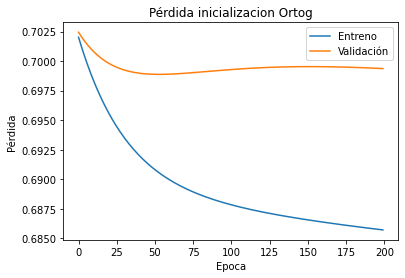

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 14:55:51.296717
Epoca= 166 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 14:56:31.422069


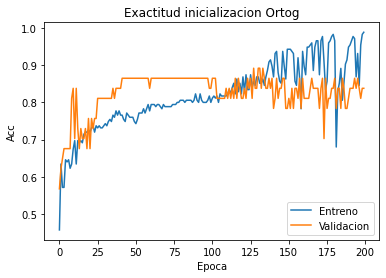

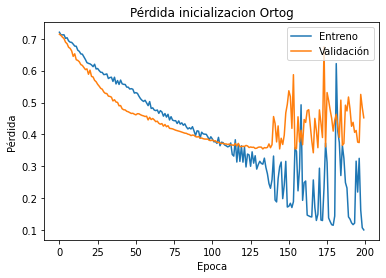

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 14:56:31.904821
Epoca= 160 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 14:57:11.142384


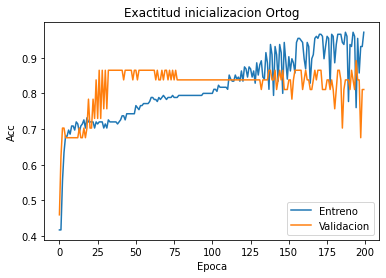

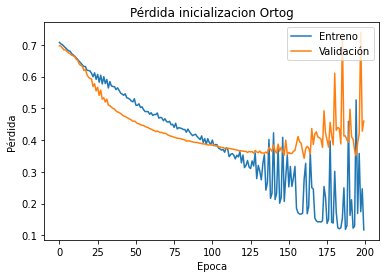

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 14:57:11.589227
Epoca= 172 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 14:57:52.328847


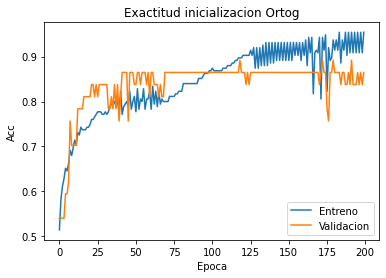

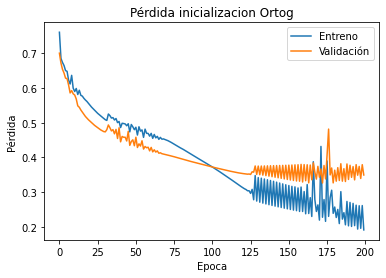

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 14:57:52.812553
Epoca= 189 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 14:58:35.227943


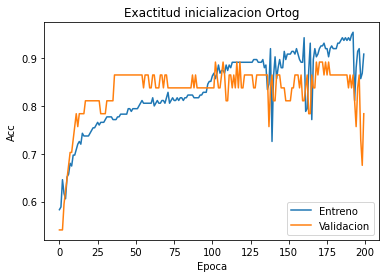

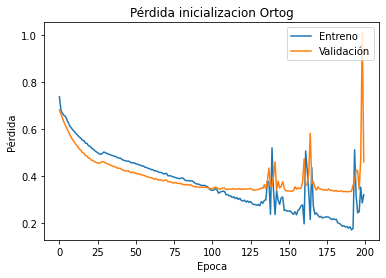

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 14:58:35.697523
Epoca= 140 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= Ortog:2020-09-19 14:59:13.025335


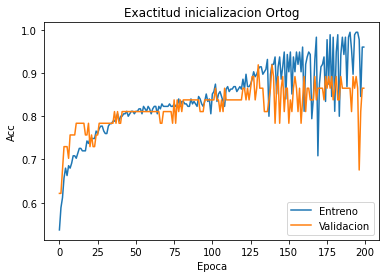

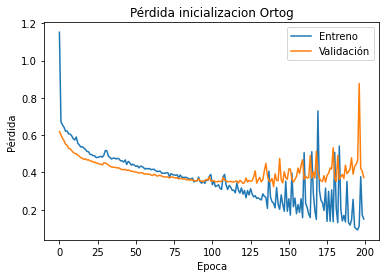

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 14:59:13.486148
Epoca= 141 , accu_v1=0.837837815284729 , accu_v2=0.8684210777282715
Fin Init= Ortog:2020-09-19 14:59:51.304552


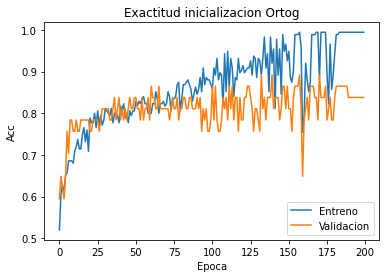

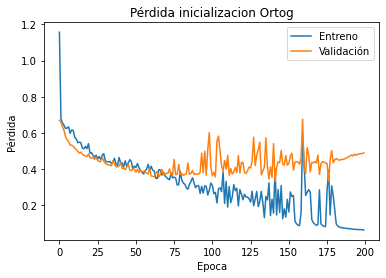

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 14:59:51.745444
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 15:00:33.007568


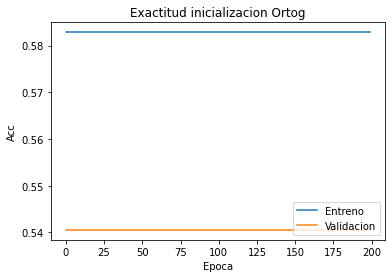

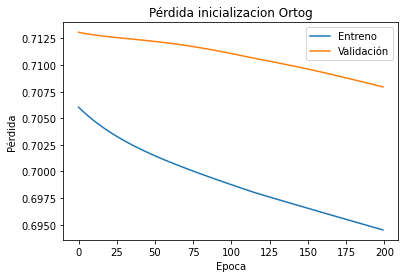

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 15:00:33.492297
Epoca= 23 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 15:01:13.779360


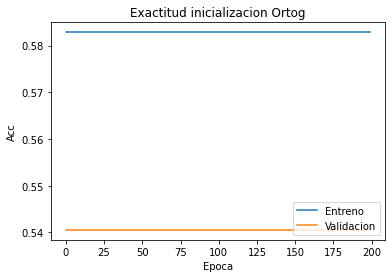

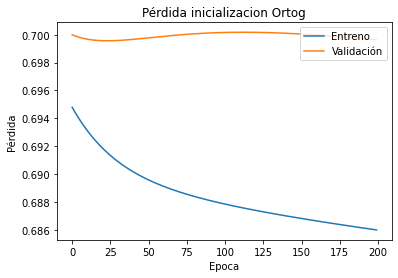

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 15:01:17.270202
Epoca= 145 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:03:35.868853


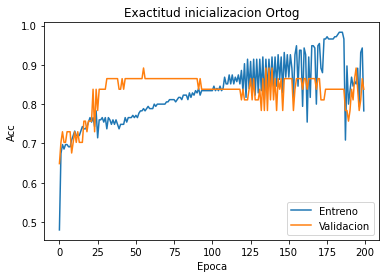

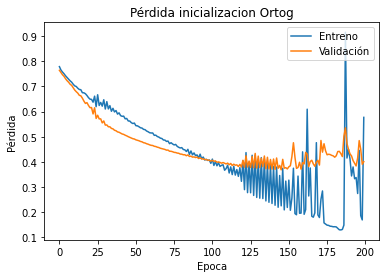

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 15:03:39.333624
Epoca= 124 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:05:58.843851


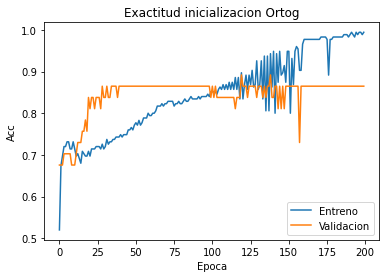

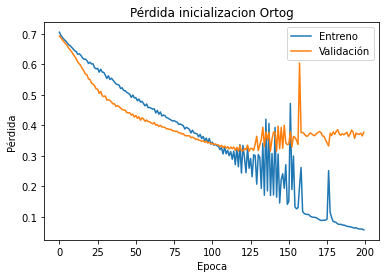

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 15:06:02.179933
Epoca= 130 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:08:22.034488


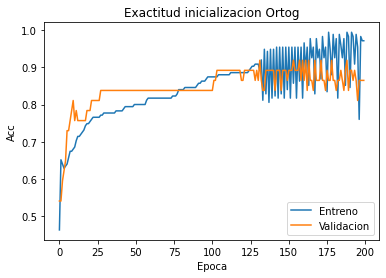

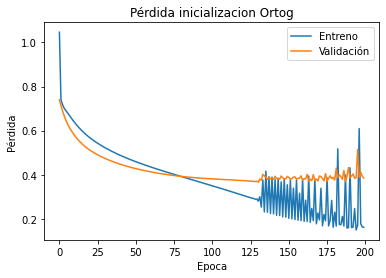

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 15:08:25.366870
Epoca= 151 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:10:54.155108


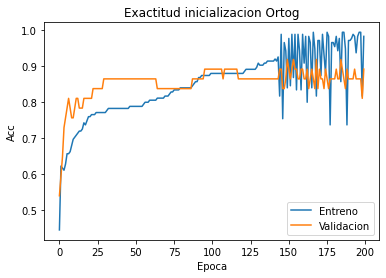

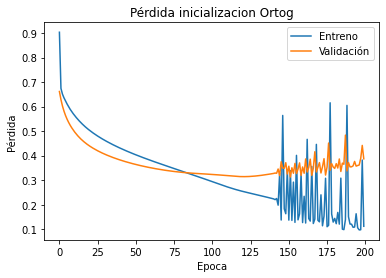

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 15:10:57.718615
Epoca= 134 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= Ortog:2020-09-19 15:13:13.374424


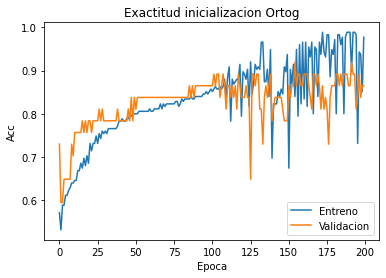

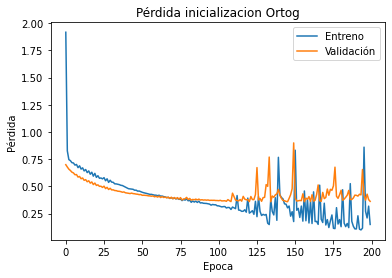

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 15:13:16.834208
Epoca= 84 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= Ortog:2020-09-19 15:15:33.323050


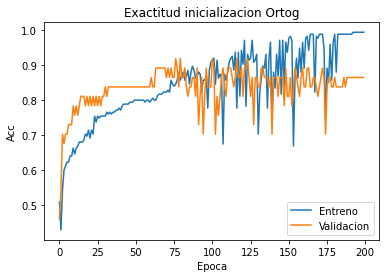

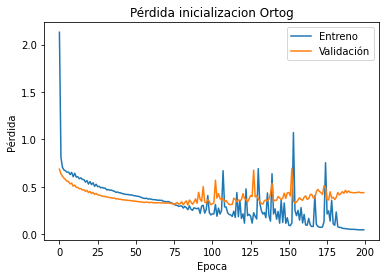

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 15:15:36.709993
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 15:18:25.897462


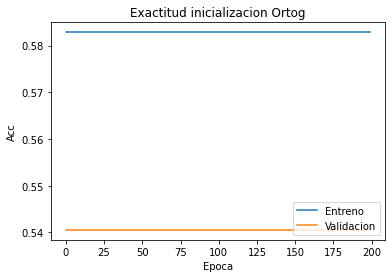

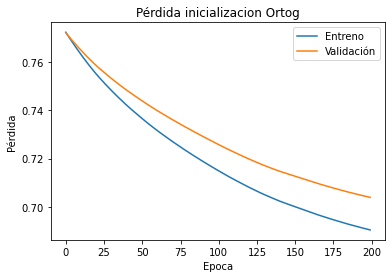

Inicio Init=Ortog
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 15:18:29.237265
Epoca= 59 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 15:20:37.996082


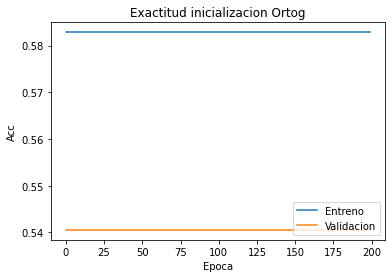

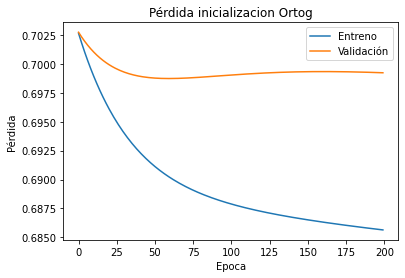

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 15:20:40.012703
Epoca= 187 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:24:34.104806


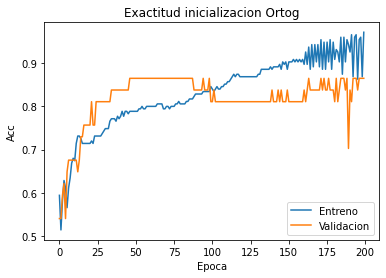

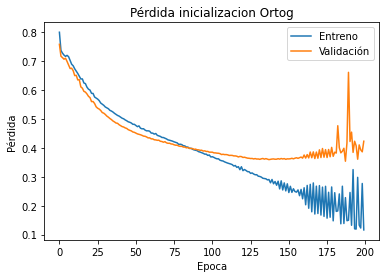

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 15:24:36.278975
Epoca= 166 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:28:20.587905


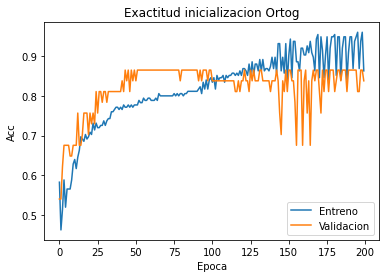

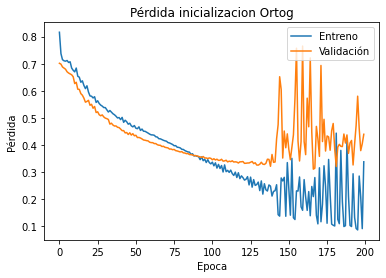

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 15:28:22.632482
Epoca= 167 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:32:10.788202


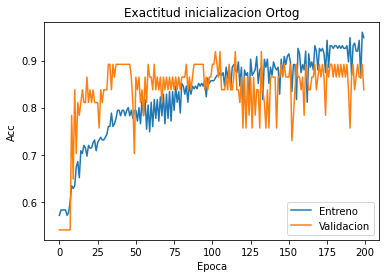

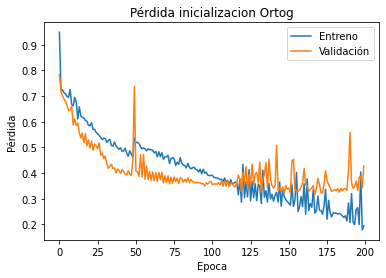

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 15:32:13.269566
Epoca= 132 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:35:42.772951


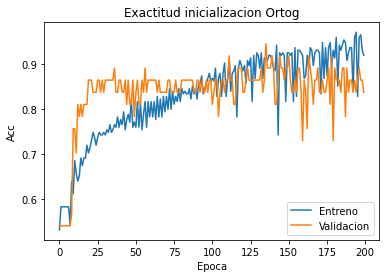

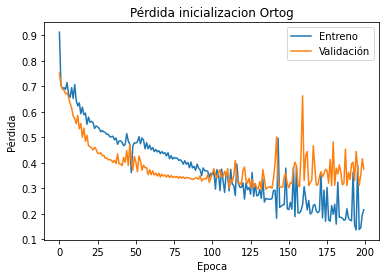

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 15:35:44.966123
Epoca= 89 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:38:51.598794


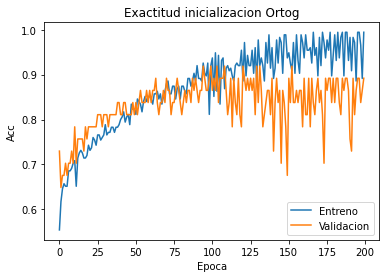

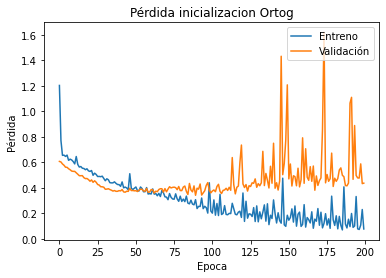

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 15:38:53.791977
Epoca= 86 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:41:58.767298


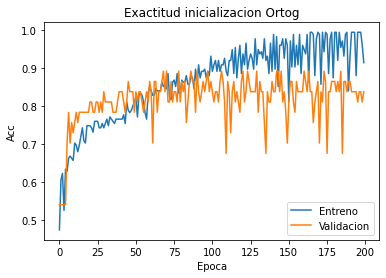

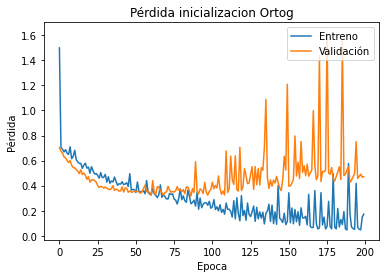

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 15:42:00.806818
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 15:46:05.961781


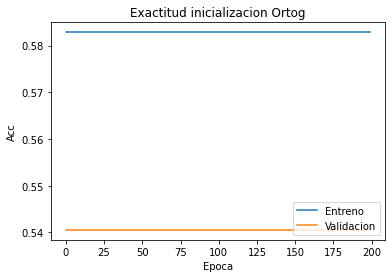

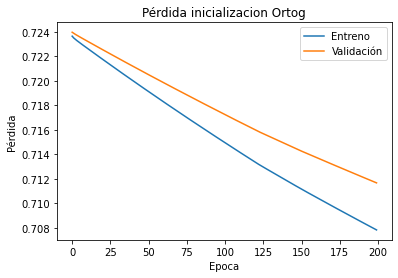

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 15:46:08.130022
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 15:50:09.561264


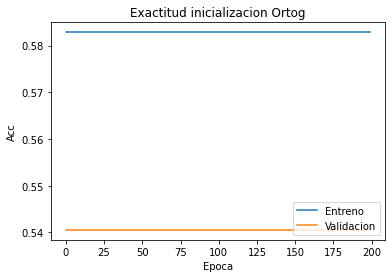

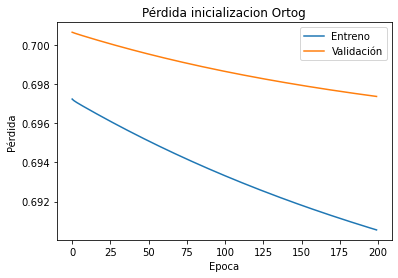

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 15:50:10.029057
Epoca= 197 , accu_v1=0.837837815284729 , accu_v2=0.8157894611358643
Fin Init= Ortog:2020-09-19 15:51:19.262909


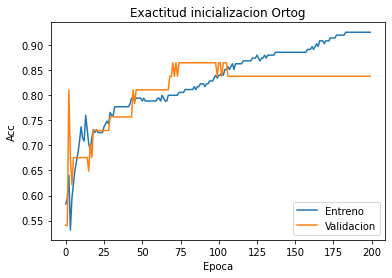

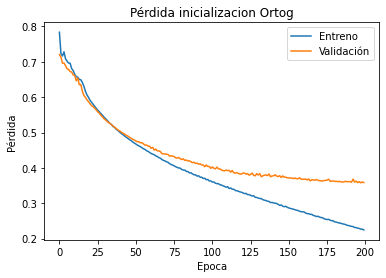

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 15:51:19.726669
Epoca= 193 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:52:28.300841


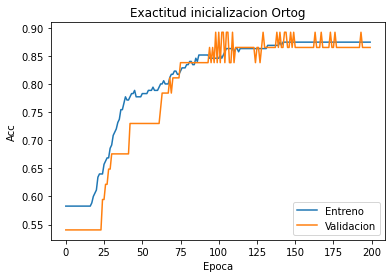

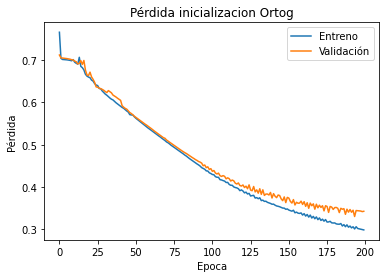

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 15:52:28.797732
Epoca= 186 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643
Fin Init= Ortog:2020-09-19 15:53:36.668755


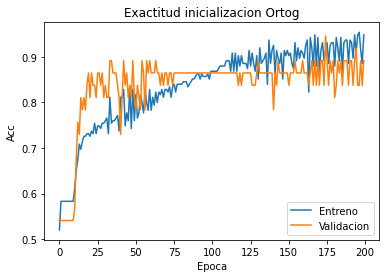

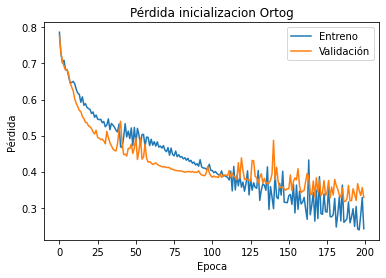

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 15:53:37.158412
Epoca= 199 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643
Fin Init= Ortog:2020-09-19 15:54:46.145747


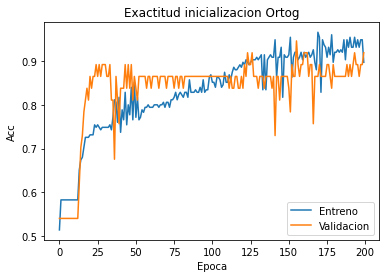

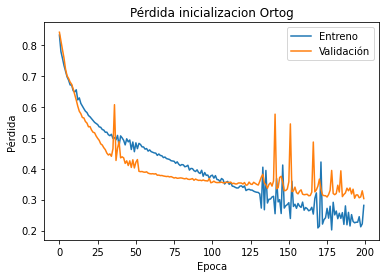

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 15:54:46.590591
Epoca= 177 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:55:51.543467


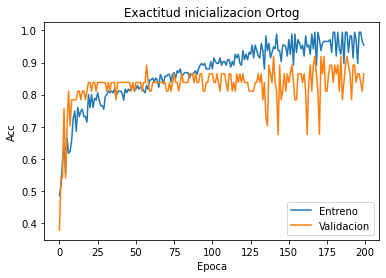

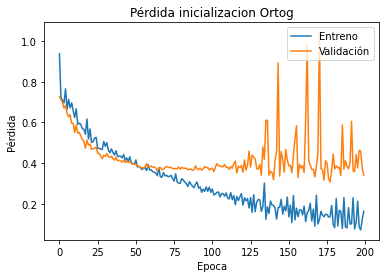

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 15:55:51.978329
Epoca= 127 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 15:56:52.969822


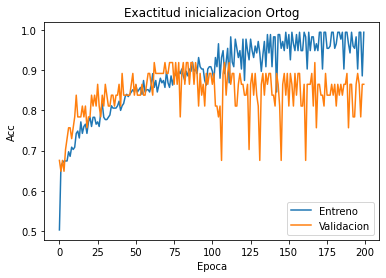

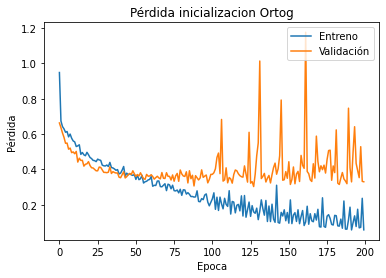

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 15:56:53.707891
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 15:58:03.098045


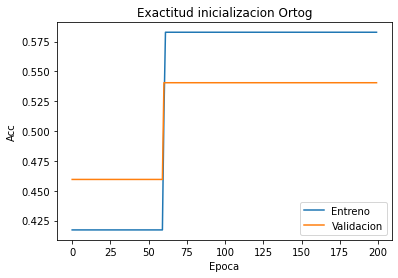

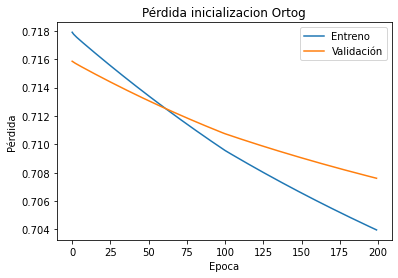

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 15:58:03.566791
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 15:59:13.160027


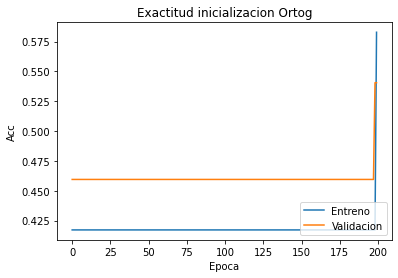

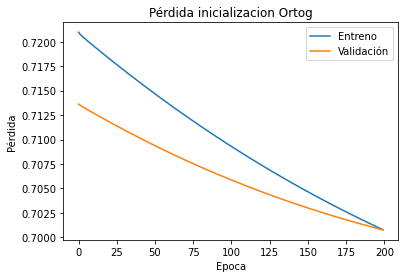

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 15:59:16.588802
Epoca= 129 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 16:03:58.848783


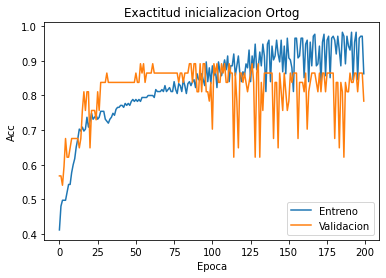

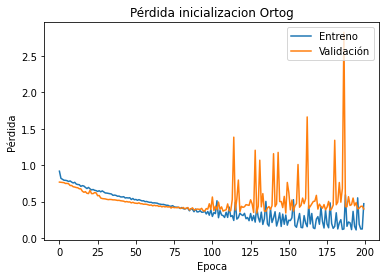

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 16:04:02.488050
Epoca= 111 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 16:08:28.843518


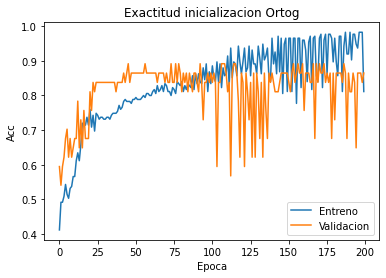

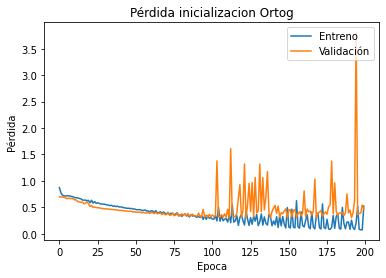

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 16:08:32.485870
Epoca= 138 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643
Fin Init= Ortog:2020-09-19 16:13:21.531102


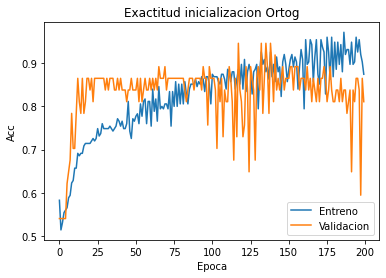

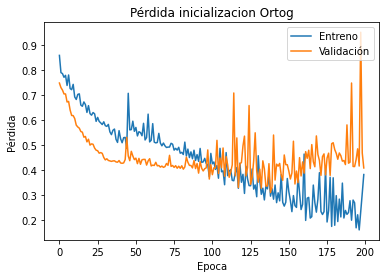

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 16:13:24.927026
Epoca= 149 , accu_v1=0.837837815284729 , accu_v2=0.8157894611358643
Fin Init= Ortog:2020-09-19 16:18:23.291224


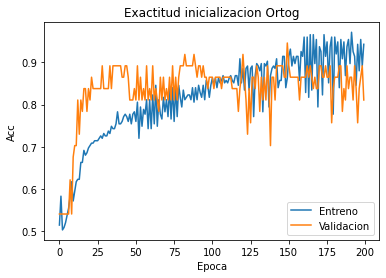

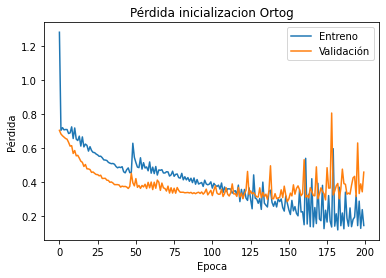

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 16:18:27.100039
Epoca= 74 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= Ortog:2020-09-19 16:22:29.172902


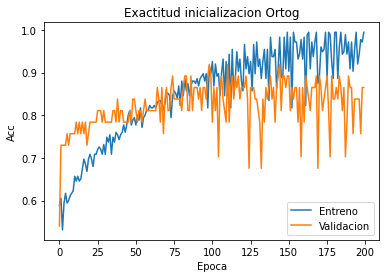

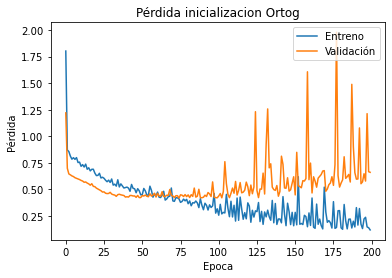

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 16:22:33.624272
Epoca= 98 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= Ortog:2020-09-19 16:26:54.286959


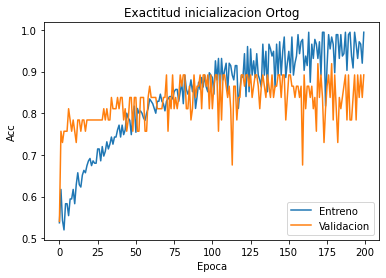

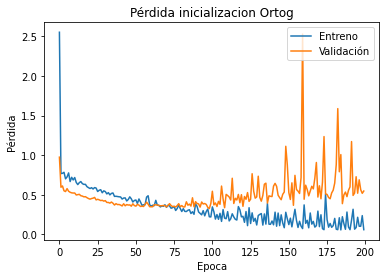

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 16:26:57.872379
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 16:32:48.694466


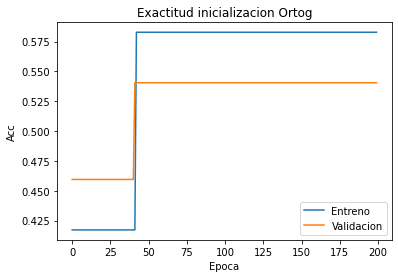

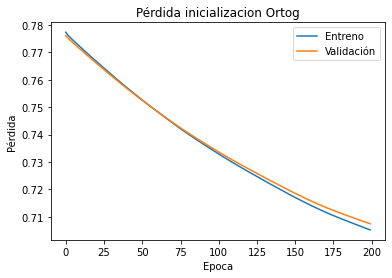

Inicio Init=Ortog
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 16:32:52.185160
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= Ortog:2020-09-19 16:38:44.475997


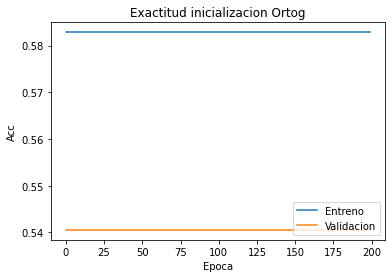

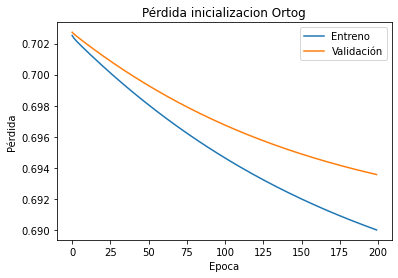

Inicio Init=norm
Optim=SGD
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 16:38:44.834110
Epoca= 199 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 16:40:42.685157


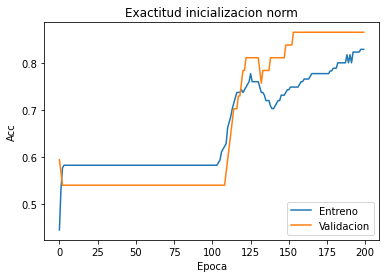

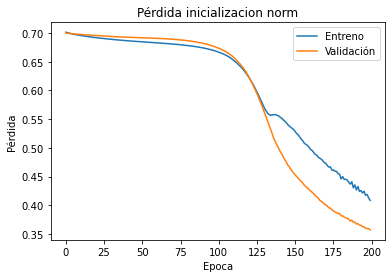

Inicio Init=norm
Optim=SGD
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 16:40:43.045230
Epoca= 199 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 16:42:41.446289


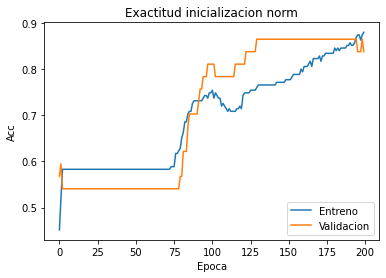

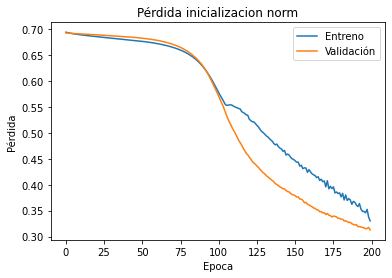

Inicio Init=norm
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 16:42:41.847217
Epoca= 199 , accu_v1=0.837837815284729 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 16:44:42.410418


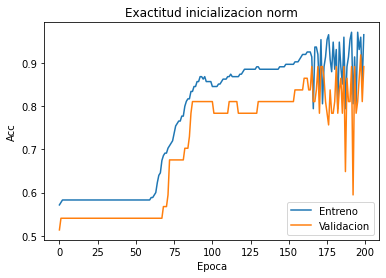

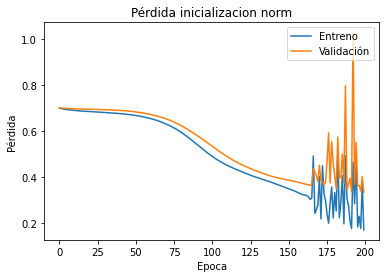

Inicio Init=norm
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 16:44:42.767465
Epoca= 170 , accu_v1=0.837837815284729 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 16:46:44.979162


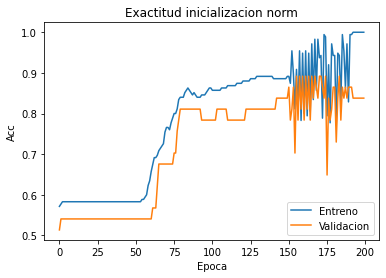

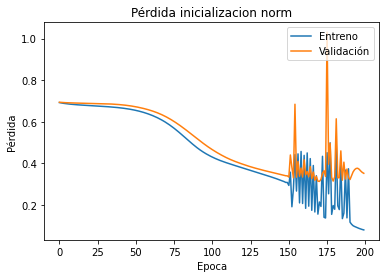

Inicio Init=norm
Optim=SGD
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 16:46:45.325237
Epoca= 112 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 16:48:34.870561


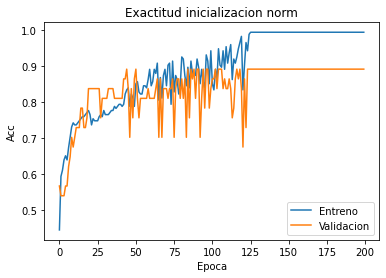

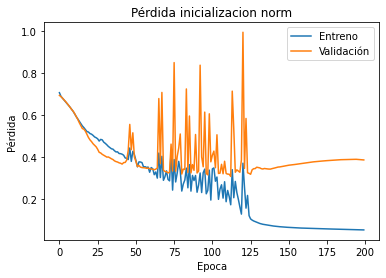

Inicio Init=norm
Optim=SGD
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 16:48:35.221657
Epoca= 83 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 16:50:19.659522


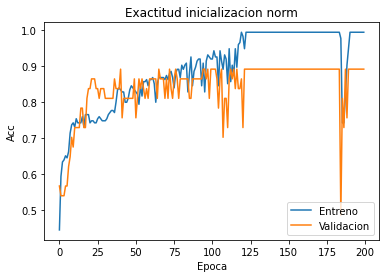

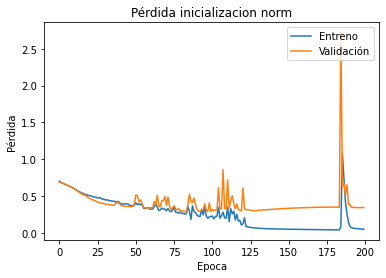

Inicio Init=norm
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 16:50:20.038021
Epoca= 162 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 16:52:19.934106


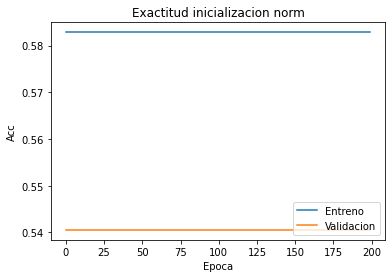

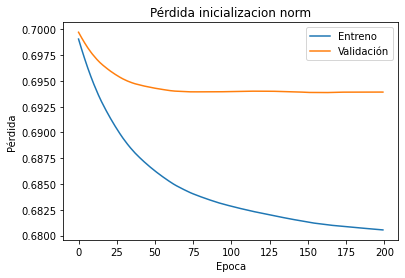

Inicio Init=norm
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 16:52:20.284169
Epoca= 37 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 16:53:44.980282


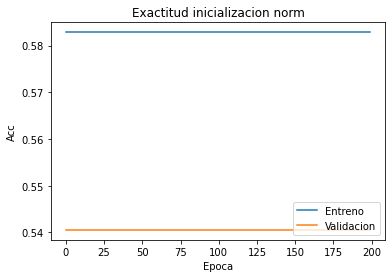

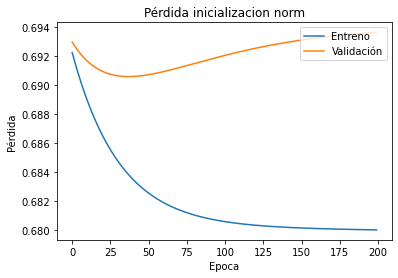

Inicio Init=norm
Optim=SGD
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 16:53:45.277486
Epoca= 58 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 16:54:42.875407


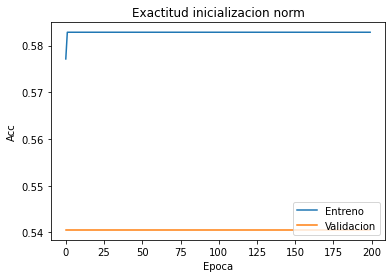

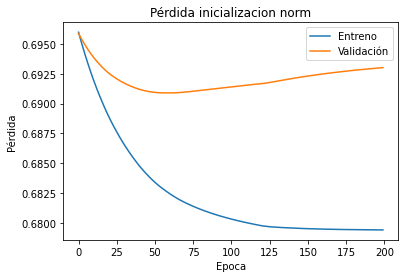

Inicio Init=norm
Optim=SGD
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 16:54:43.152666
Epoca= 43 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 16:55:48.461751


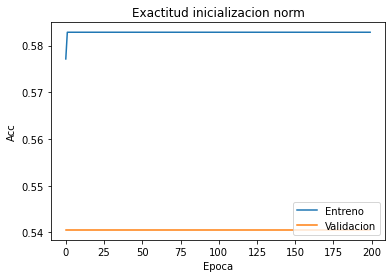

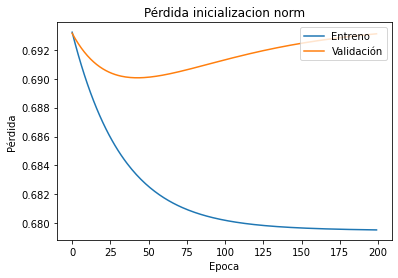

Inicio Init=norm
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 16:55:49.023250
Epoca= 56 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 16:56:42.087508


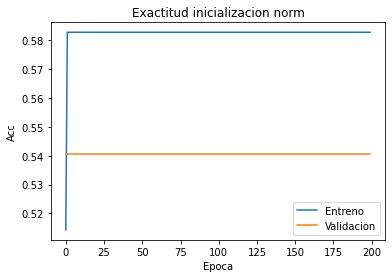

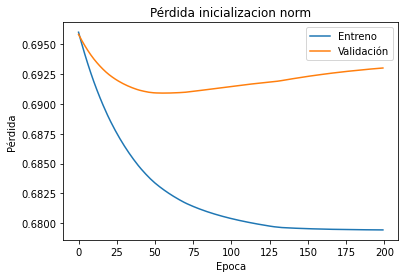

Inicio Init=norm
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 16:56:42.376734
Epoca= 42 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 16:57:42.272111


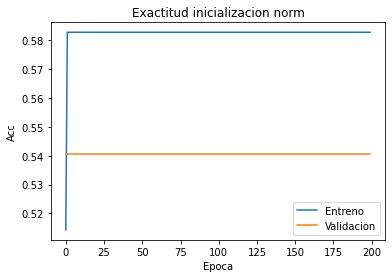

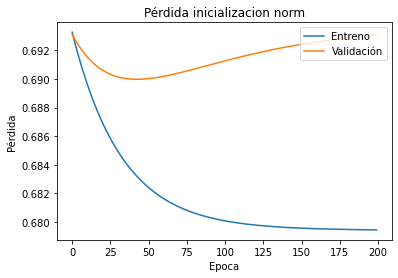

Inicio Init=norm
Optim=SGD
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 16:57:42.566350
Epoca= 59 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 16:58:43.705596


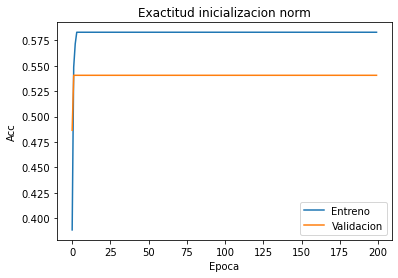

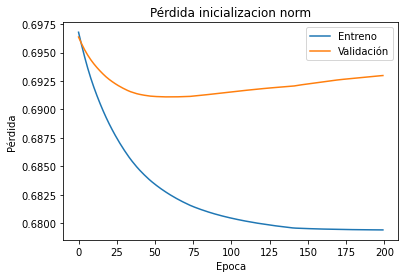

Inicio Init=norm
Optim=SGD
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 16:58:43.997789
Epoca= 199 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 16:59:41.813078


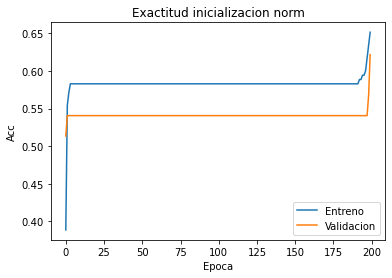

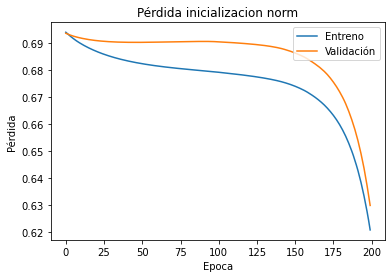

Inicio Init=norm
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 16:59:42.144230
Epoca= 49 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 17:00:47.431135


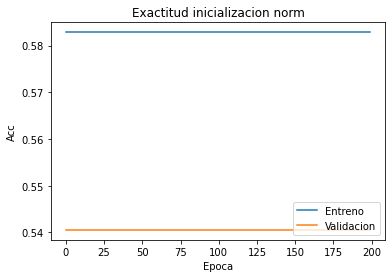

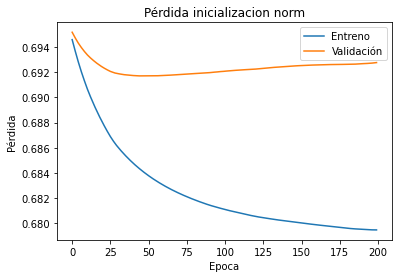

Inicio Init=norm
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 17:00:47.764279
Epoca= 35 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 17:01:34.600665


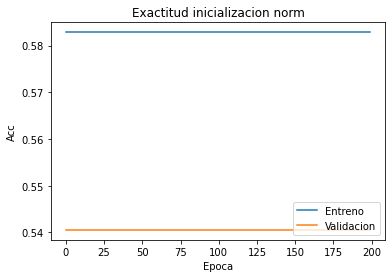

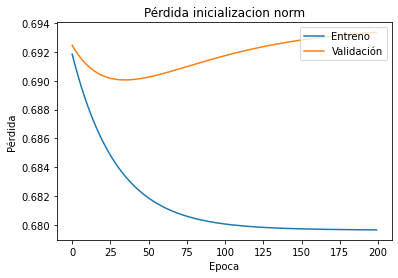

Inicio Init=norm
Optim=SGD
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 17:01:35.062426
Epoca= 108 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 17:03:46.788960


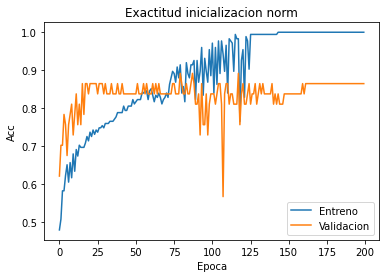

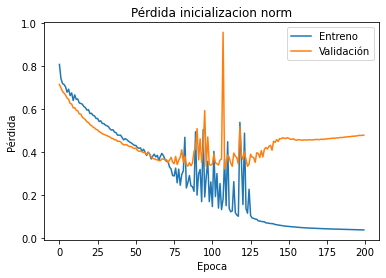

Inicio Init=norm
Optim=SGD
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 17:03:47.179863
Epoca= 94 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 17:05:48.047513


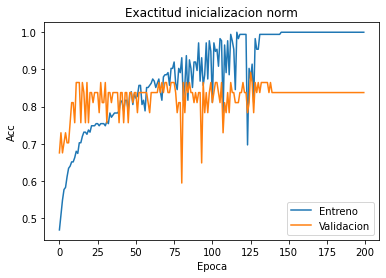

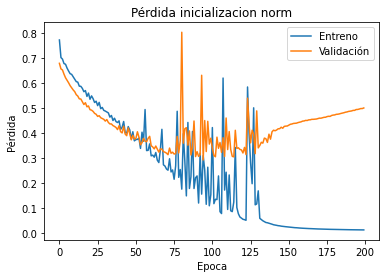

Inicio Init=norm
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 17:05:48.584247
Epoca= 73 , accu_v1=0.837837815284729 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 17:07:42.977789


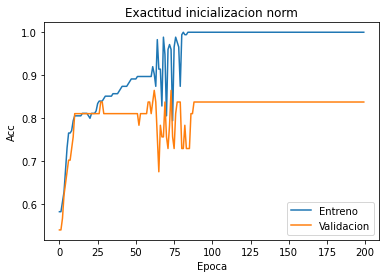

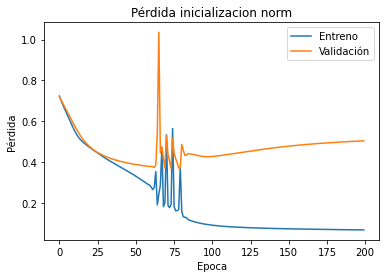

Inicio Init=norm
Optim=SGD
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 17:07:43.458070
Epoca= 84 , accu_v1=0.837837815284729 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 17:09:40.479076


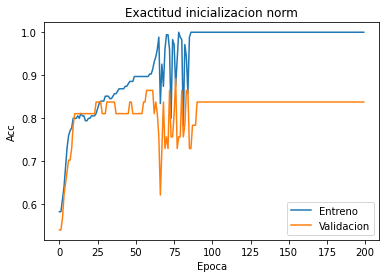

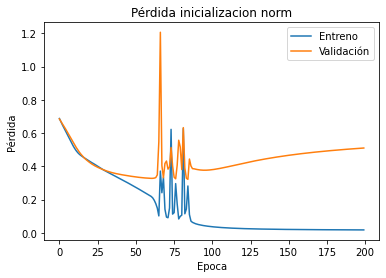

Inicio Init=norm
Optim=SGD
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 17:09:40.886985
Epoca= 45 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 17:11:32.178059


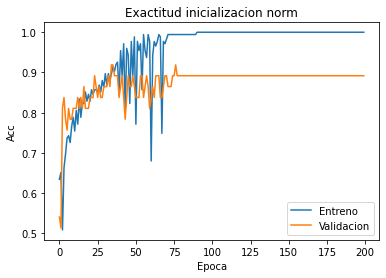

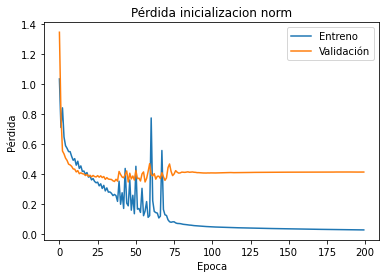

Inicio Init=norm
Optim=SGD
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 17:11:32.574000
Epoca= 39 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 17:13:20.803588


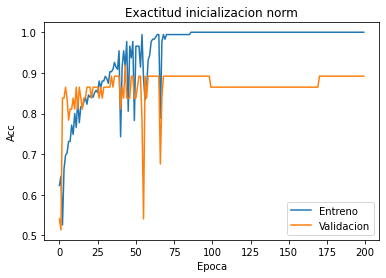

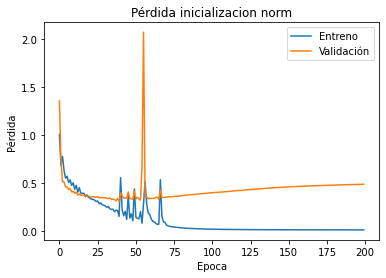

Inicio Init=norm
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 17:13:21.284303
Epoca= 196 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 17:16:05.000612


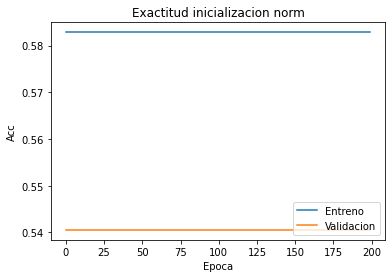

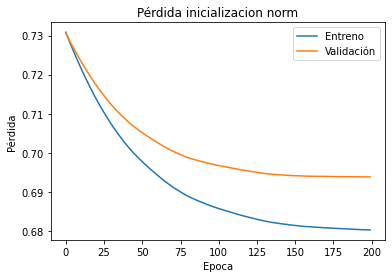

Inicio Init=norm
Optim=SGD
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 17:16:05.399580
Epoca= 44 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 17:18:04.991838


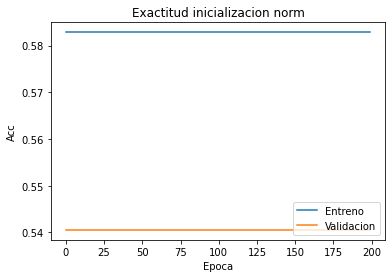

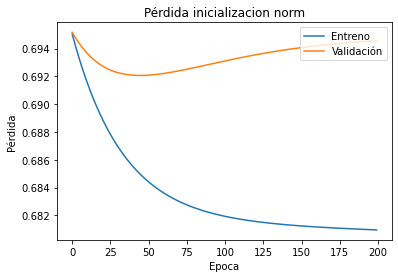

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 17:18:05.445626
Epoca= 196 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 17:22:12.549772


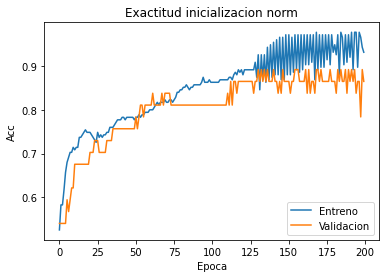

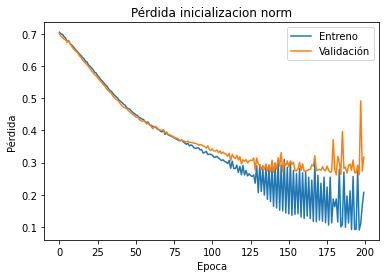

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 17:22:12.921776
Epoca= 173 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 17:26:12.334880


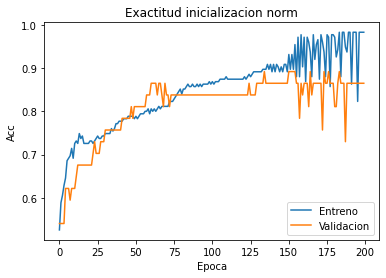

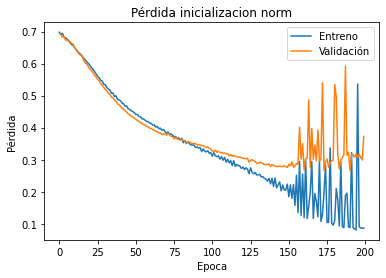

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 17:26:12.706910
Epoca= 180 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 17:30:15.481693


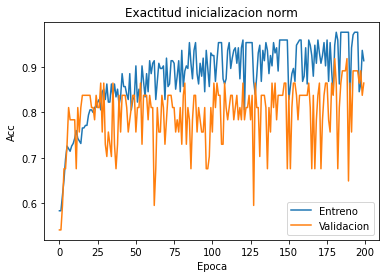

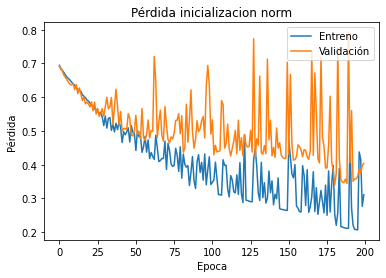

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 17:30:15.849709
Epoca= 196 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 17:34:16.574899


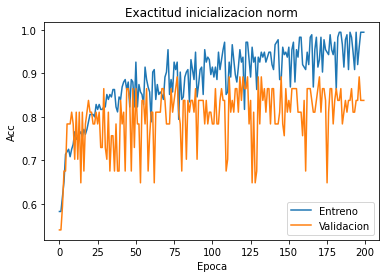

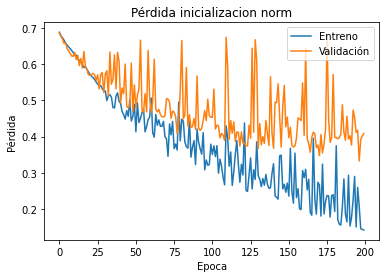

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 17:34:16.956876
Epoca= 67 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 17:37:15.563355


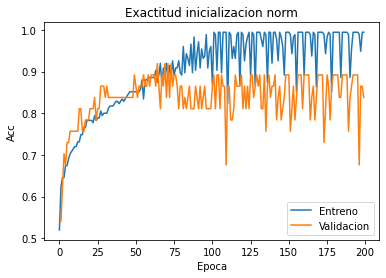

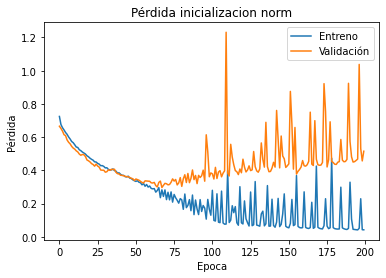

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 17:37:16.255544
Epoca= 93 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 17:40:25.326386


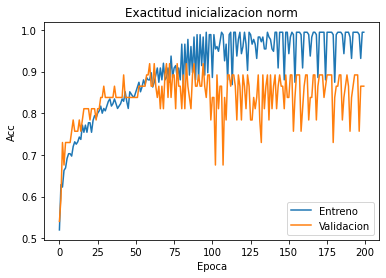

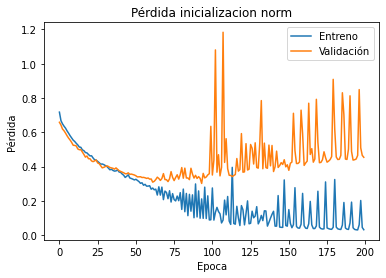

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L1:2020-09-19 17:40:25.689415
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 17:44:33.596476


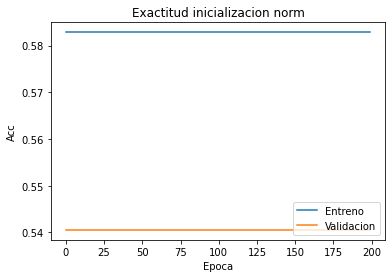

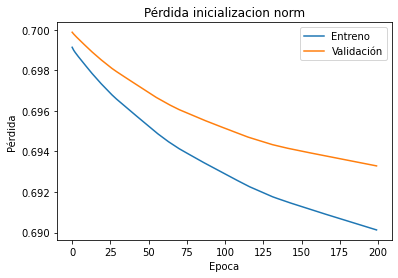

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[700, 400, 100, 50, 15]
Regularizer=L2:2020-09-19 17:44:34.001393
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 17:48:35.605595


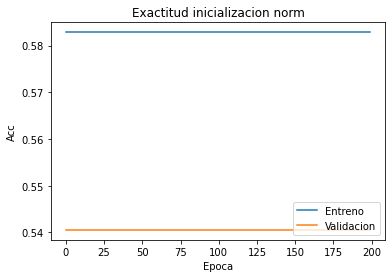

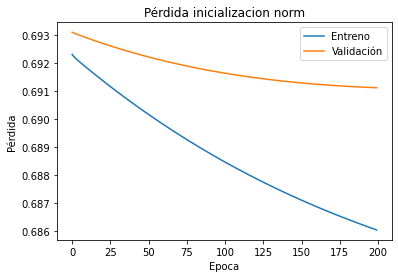

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 17:48:36.190058
Epoca= 199 , accu_v1=0.8108108043670654 , accu_v2=0.8157894611358643
Fin Init= norm:2020-09-19 17:49:48.395118


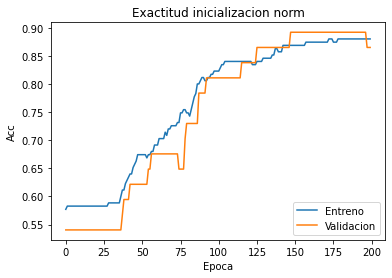

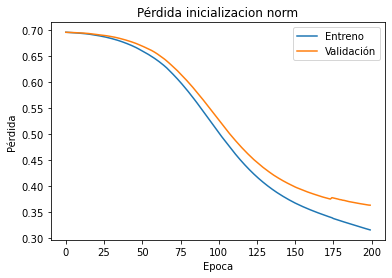

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 17:49:48.758149
Epoca= 192 , accu_v1=0.8108108043670654 , accu_v2=0.8157894611358643
Fin Init= norm:2020-09-19 17:50:59.549304


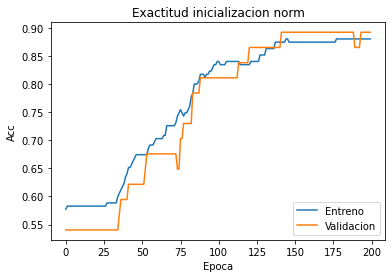

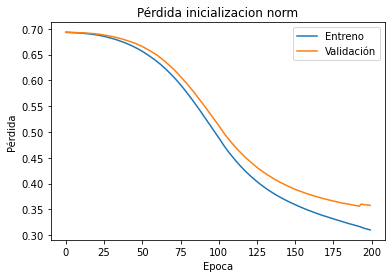

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 17:50:59.849501
Epoca= 183 , accu_v1=0.7837837934494019 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 17:52:08.894775


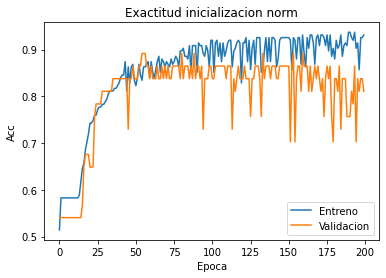

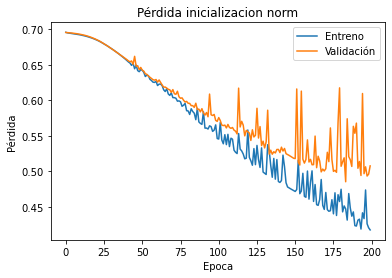

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 17:52:09.180037
Epoca= 192 , accu_v1=0.7837837934494019 , accu_v2=0.8157894611358643
Fin Init= norm:2020-09-19 17:53:21.870051


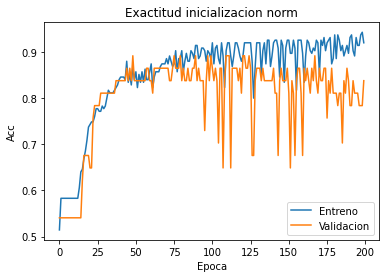

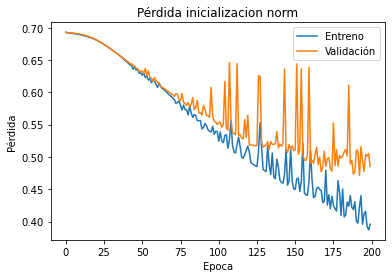

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 17:53:22.157308
Epoca= 193 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 17:54:31.755455


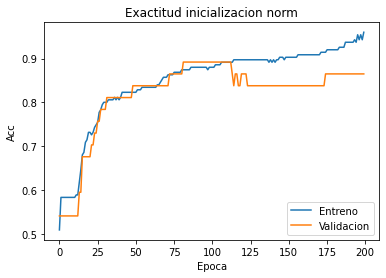

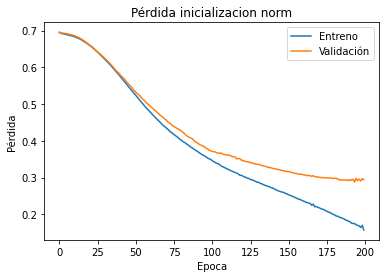

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 17:54:32.035705
Epoca= 196 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 17:55:49.846349


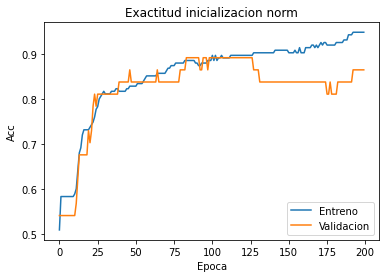

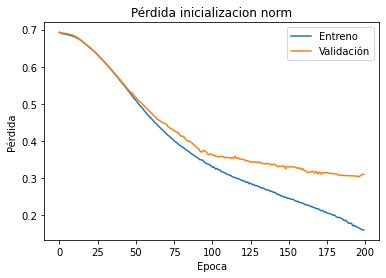

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L1:2020-09-19 17:55:50.130590
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 17:57:02.709145


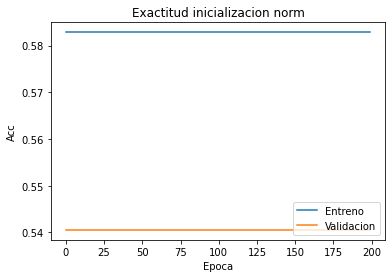

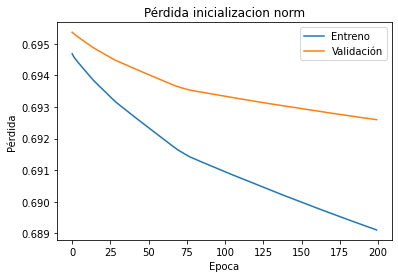

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[128, 64, 32, 16, 8]
Regularizer=L2:2020-09-19 17:57:03.046245
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 17:58:15.596357


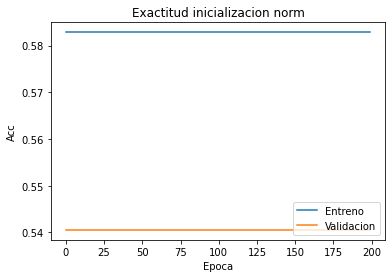

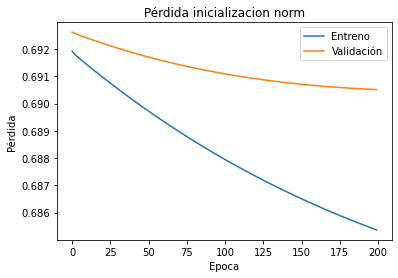

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 17:58:16.000277
Epoca= 127 , accu_v1=0.8918918967247009 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 18:02:56.622109


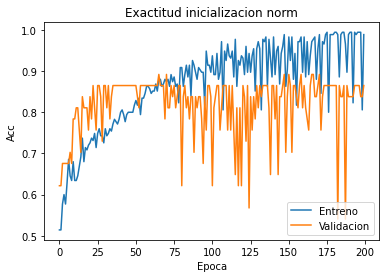

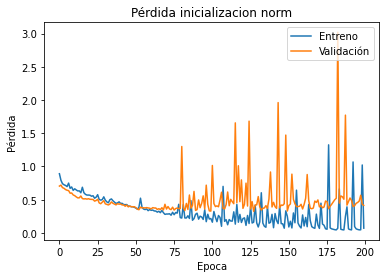

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=relu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 18:02:57.160669
Epoca= 93 , accu_v1=0.837837815284729 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 18:07:13.444682


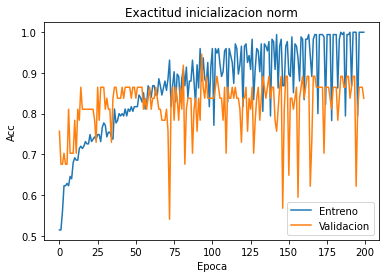

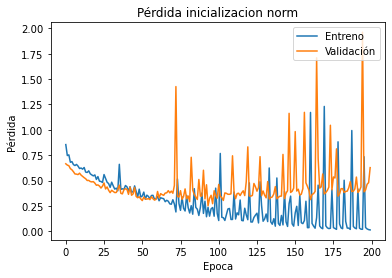

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 18:07:13.931382
Epoca= 67 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
Fin Init= norm:2020-09-19 18:11:12.118275


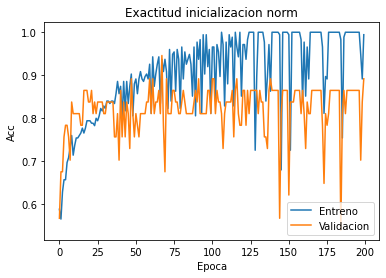

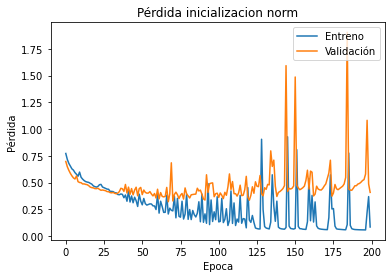

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=tanh
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 18:11:12.611954
Epoca= 60 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 18:15:13.724960


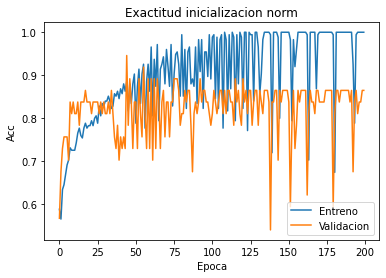

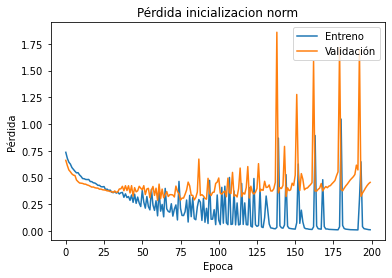

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 18:15:14.148816
Epoca= 56 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 18:19:13.318433


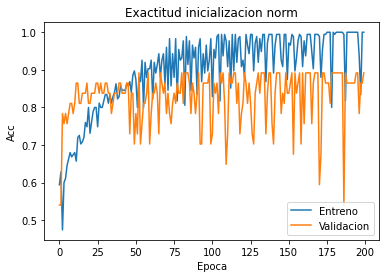

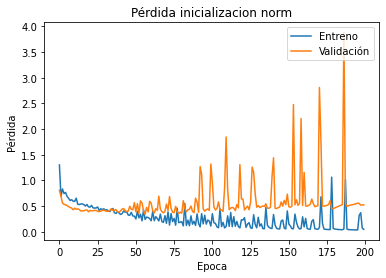

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=selu
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 18:19:13.833016
Epoca= 54 , accu_v1=0.8648648858070374 , accu_v2=0.8421052694320679
Fin Init= norm:2020-09-19 18:23:14.789586


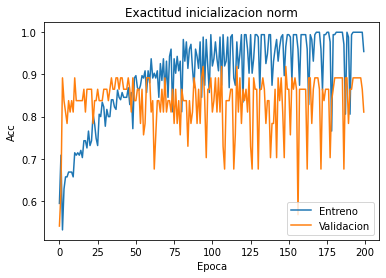

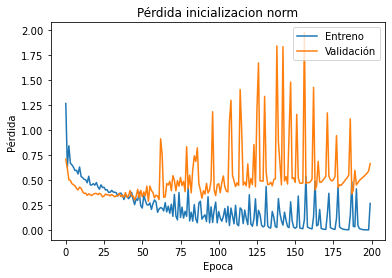

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L1:2020-09-19 18:23:15.198492
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 18:29:10.824740


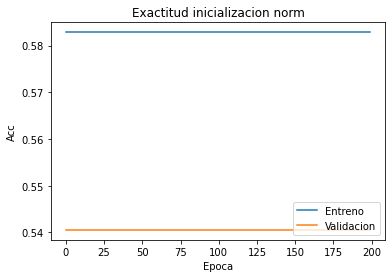

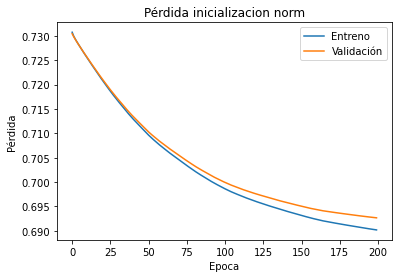

Inicio Init=norm
Optim=RMSprop
Funcion Activacion=softmax
Arquitectura=[1000, 500, 500, 250, 100]
Regularizer=L2:2020-09-19 18:29:11.244617
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6052631735801697
Fin Init= norm:2020-09-19 18:35:14.749463


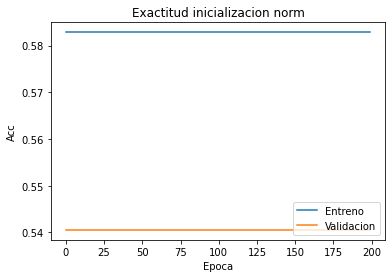

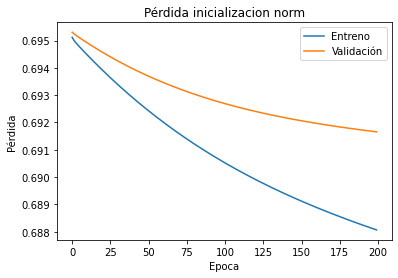

+--------+--------+--------+-------+-------+-------------+-------------+----------------------------+------------+
| Exac_E | Exac_V | Exac_P | Epoca |  Init | Regularizer | Optimizador |        Arquitectura        | Activacion |
+--------+--------+--------+-------+-------+-------------+-------------+----------------------------+------------+
|  1.0   | 0.8378 | 0.8421 |  130  |   He  |      L1     |     SGD     |  [700, 400, 100, 50, 15]   |    relu    |
|  1.0   | 0.8649 | 0.8421 |  116  |   He  |      L2     |     SGD     |  [700, 400, 100, 50, 15]   |    relu    |
|  1.0   | 0.8649 | 0.8684 |  194  |   He  |      L1     |     SGD     |  [700, 400, 100, 50, 15]   |    tanh    |
|  1.0   | 0.8649 | 0.8684 |  182  |   He  |      L2     |     SGD     |  [700, 400, 100, 50, 15]   |    tanh    |
| 0.5829 | 0.5405 | 0.6053 |  199  |   He  |      L1     |     SGD     |  [700, 400, 100, 50, 15]   |    selu    |
| 0.5829 | 0.5405 | 0.6053 |  199  |   He  |      L2     |     SGD     |  [700, 

In [29]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca", "Init", "Regularizer", "Optimizador","Arquitectura","Activacion"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=200

# implementamos 2 repeticiones, una con inicializacion aleatoria Normal y otra con He
for i in range(4):
    for j in range(2):
        for k in range(3):
            for l in range(4):
                for m in range(2):

                    model = Sequential()   
                    model.add(Flatten(input_shape=X.shape[1:]))
                    model.add(Dense(Neuronas[k][0], activation=Fun_Activacion[l], kernel_initializer=Mto_Inicial[list(Mto_Inicial.keys())[i]], bias_initializer='zeros')) 
                    model.add(Dense(Neuronas[k][1], activation=Fun_Activacion[l], kernel_initializer=Mto_Inicial[list(Mto_Inicial.keys())[i]], bias_initializer='zeros'))
                    model.add(Dense(Neuronas[k][2], activation=Fun_Activacion[l], kernel_initializer=Mto_Inicial[list(Mto_Inicial.keys())[i]], bias_initializer='zeros'))
                    model.add(Dense(Neuronas[k][3], activation=Fun_Activacion[l], kernel_initializer=Mto_Inicial[list(Mto_Inicial.keys())[i]], bias_initializer='zeros'))
                    model.add(Dense(Neuronas[k][4], activation=Fun_Activacion[l], kernel_initializer=Mto_Inicial[list(Mto_Inicial.keys())[i]], bias_initializer='zeros'))
                    model.add(Dense(1, activation='sigmoid', kernel_initializer=Mto_Inicial[list(Mto_Inicial.keys())[i]], bias_initializer='zeros', kernel_regularizer=Regula[list(Regula.keys())[m]])) 

                    init = list(Mto_Inicial.keys())[i]
                    Arquitec = Neuronas[k]
                    Activa = Fun_Activacion[l]
                    tiempo0 = datetime.datetime.now()
                    regularizer = list(Regula.keys())[m]
                    optim = list(Optimizador.keys())[j]
                    print('Inicio Init=' +str(init))
                    print('Optim=' +str(optim))
                    print('Funcion Activacion=' +str(Activa))
                    print('Arquitectura=' +str(Arquitec))
                    print('Regularizer=' +str(regularizer)+':' +str(tiempo0))


                    # Partimos los datos en entrenamiento y doble validación
                    CE_x, CV0_x, CE_y, CV0_y = train_test_split(X, Y.T, test_size = 0.3, random_state = 8)
                    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = 8)

                    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
                    model.compile(loss='binary_crossentropy', optimizer=Optimizador[list(Optimizador.keys())[j]], metrics=['accuracy'])

                    # Ajustamos el modelo
                    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)  

                    # Encontramos el mejor modelo en validación
                    min_err=np.min(history.history['val_loss'])
                    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 

                    # Conseguimos el mejor modelo de acuerdo con su desempeño en la primera validación
                    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)

                    # Calculamos las metricas
                    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
                    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
                    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)

                    # Guardamos las métricas de desempeño
                    accu_e = train_metrics[1]
                    loss_e = train_metrics[0]
                    accu_v = valid_metrics[1]
                    loss_v = valid_metrics[0]
                    accu_p = test_metrics[1]
                    loss_p = test_metrics[0]

                    pathr =('Redprofunda_'+str(init)+'Arqui'+str(k)+'Activ'+str(Activa)+'Reg'+str(regularizer)+'opt'+str(optim)+'.h5')
                    model.save(pathr) 
                    err_p = loss_p

                    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0], init, regularizer, optim,Arquitec,Activa])

                    # Imprimimos el desempeño para cada inicializacion y el tiempo en completar las iteraciones
                    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
                    tiempo1 = datetime.datetime.now()
                    print('Fin Init= ' +str(init)+':' +str(tiempo1))

                    # Graficamos el desempeño del modelo
                    plt.figure(1)
                    plt.plot(history.history['accuracy'])  
                    plt.plot(history.history['val_accuracy'])  
                    plt.title('Exactitud inicializacion ' +str(init))  
                    plt.ylabel('Acc')  
                    plt.xlabel('Epoca')  
                    plt.legend(['Entreno', 'Validacion'], loc='lower right')
                    plt.show()

                    plt.figure(1) 
                    plt.plot(history.history['loss'])  
                    plt.plot(history.history['val_loss'])  
                    plt.title('Pérdida inicializacion ' +str(init))  
                    plt.ylabel('Pérdida')  
                    plt.xlabel('Epoca')  
                    plt.legend(['Entreno', 'Validación'], loc='upper right')  
                    plt.show()

print(x)

### Solución:

Para todos los modelos testeados anteriormente donde cambiaron la inicialización de parámetros, la penalización en la capa de salida, el optimizador, la cantidad de neuronas en las 5 capas intermedias y las funciones de activación; se encontró un máximo Accuracy de 0.8919 para diferentes combinaciones; sin embargo por criterio de parsimonia y de menor número de épocas para su convergencia se decidió escoger la siguiente combinación en los modelos:

    - Inicializador: Normal
    - Penalización: L1
    - Optimizador: RMSprop
    - Arquitectura en las capas intermedias: [700, 400, 100, 50, 15]
    - Funciones de activación: selu
   
La cantidad de épocas óptima son 67.


Lectura avanzada sobre métodos de optimización en redes profundas: https://openreview.net/pdf?id=ryQu7f-RZ
http://www.cs.utoronto.ca/~ilya/pubs/2013/1051_2.pdf

## 3. Caso aplicado

Ahora probemos nuestro modelo sobre la imagen completa de prueba del paramo ``IMG_3451.JPG``.


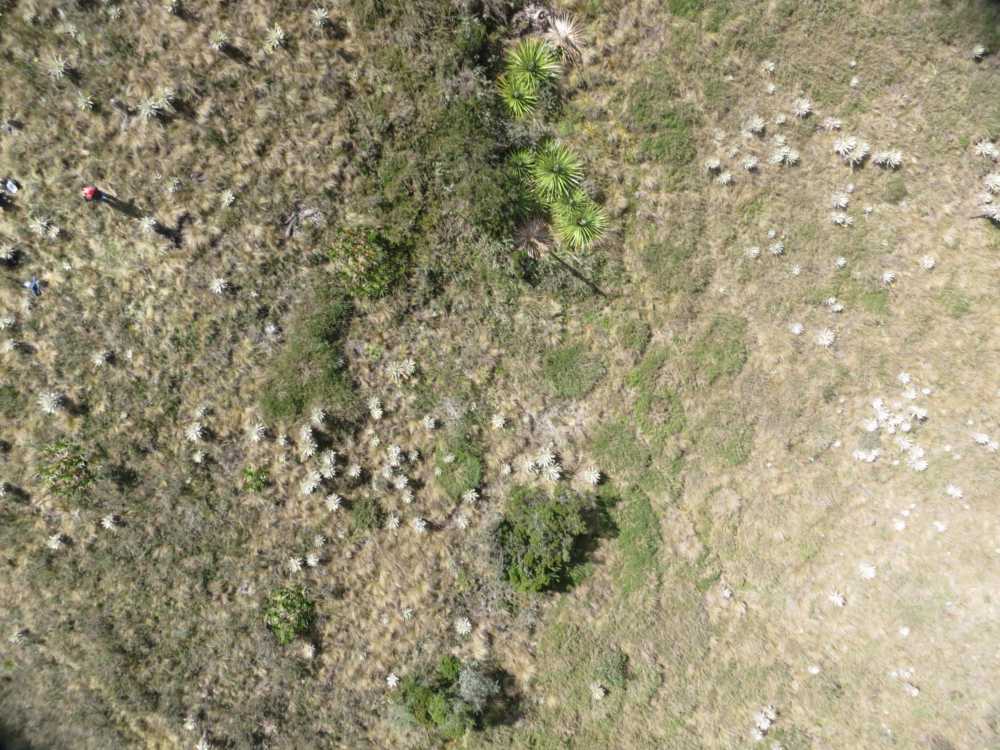

In [32]:
from keras.preprocessing import image

img = image.load_img('IMG_3451.JPG')
img 

### 3.1 Red sencilla

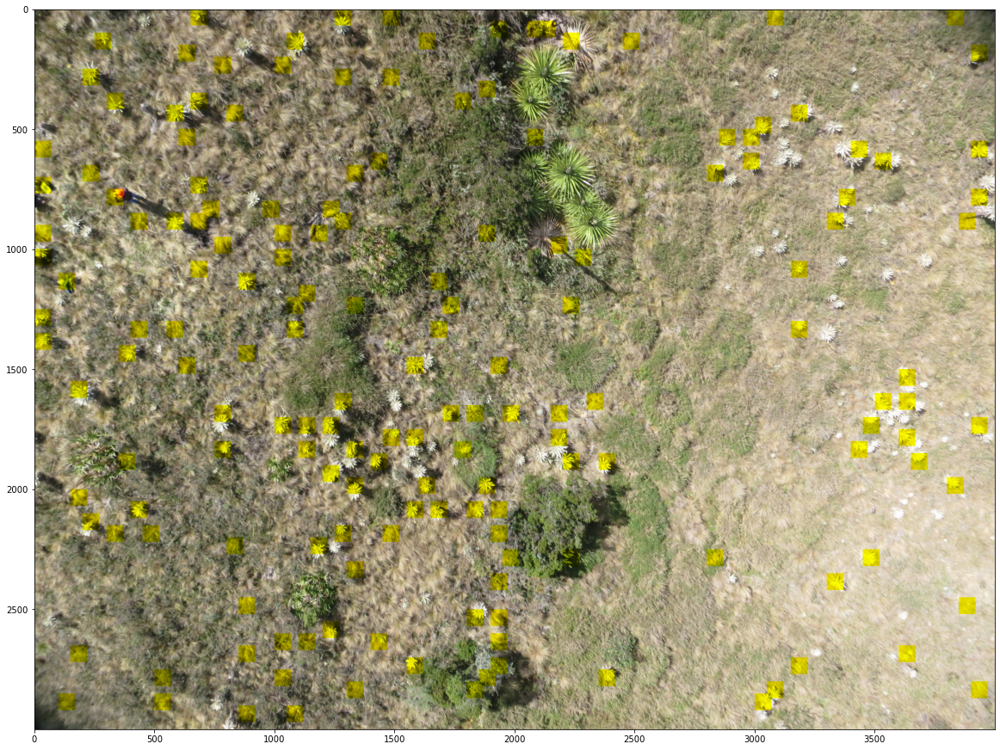

In [33]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_1.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 3.2 Red multi-capa

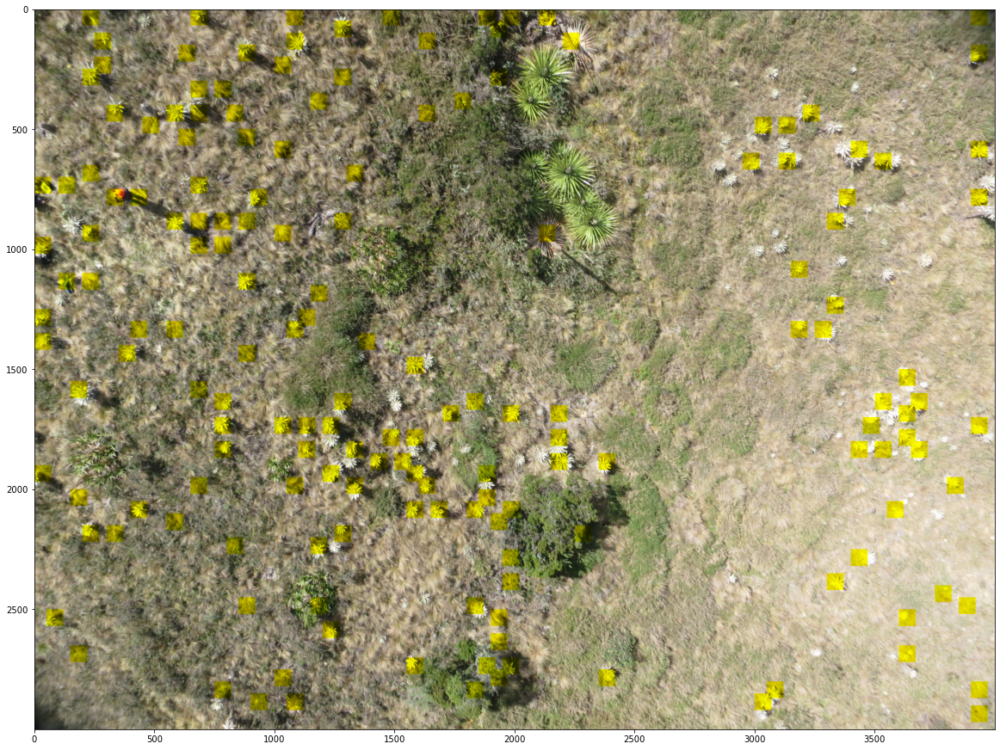

In [34]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_2.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### Pregunta

Qué puede observar sobre el desempeño de los diferentes modelos? Qué estrategias puede proponer para mejorar los modelos?

### Red de mejor desempeño


In [35]:
model_00 = load_model('Redprofunda_normArqui0ActivseluRegL1optRMSprop.h5')

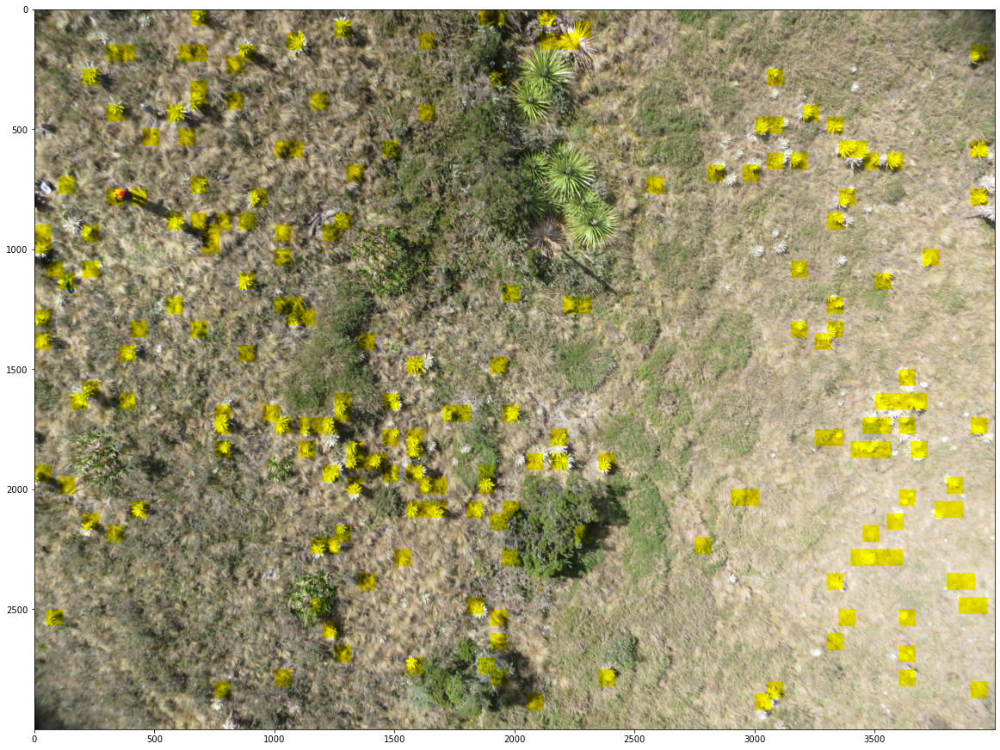

In [37]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_00.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

El desempeño de los modelos es muy similar entre si, sin embargo se ha podido establecer que la diferencia en los inicializadores y en los optimizadores marca una diferencia significativa en la estimación de cada modelo. El tercer modelo que se testea es el que mejores estadísticos de desempeño presentó en el punto anterior; este modelo parece identificar más frailejones que los dos modelos anteriores, especialmente donde hay grupos de estas plantas; sin embargo este modelo sigue presentando como falsos positivos imagenes como la de las personas y los árboles de color diferente en la parte superior de la imágen.

Una estrategia para mejorar la estimación de los frailejones sería utilizar redes convolucionales que logren identificar la forma característica de estas plantas.